# **Model Explanations and Interpretability**


## **Cross-fraction Stability Analysis**

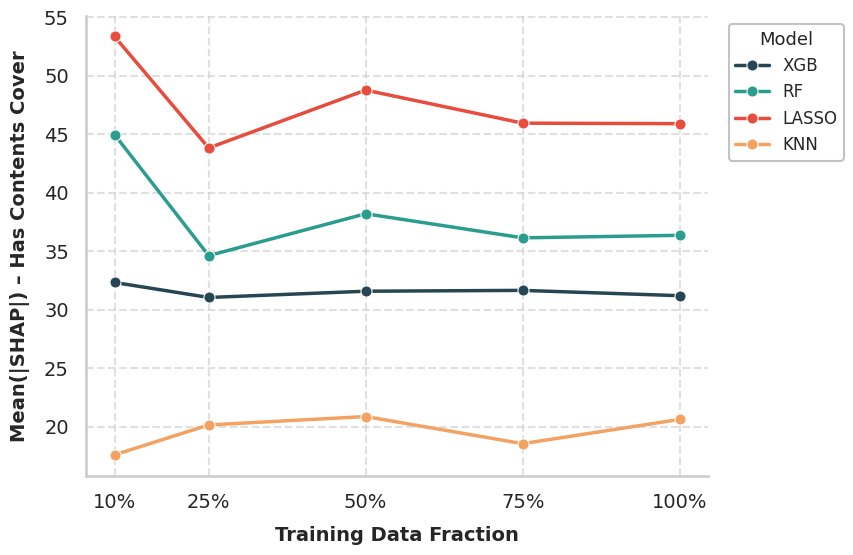

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Directories for each model
DIRS = {
    "xgb":   "/content/drive/MyDrive/MSc Research/EXPLAIN",
    "rf":    "/content/drive/MyDrive/MSc Research/Random Forest/Explain",
    "lasso": "/content/drive/MyDrive/MSc Research/Lasso",
    "knn":   "/content/drive/MyDrive/MSc Research/KNN/Explain"
}

def load_model_shap(model_name, feature_name):
    dfs = []
    for label, frac in zip(["10", "25", "50", "75", "100"], [0.10, 0.25, 0.50, 0.75, 1.00]):
        path = os.path.join(DIRS[model_name], f"{model_name}_mean_shap_{label}.csv")
        if os.path.exists(path):
            df = pd.read_csv(path)
            df["sample_frac"] = frac
            df["model"] = model_name.upper()
            dfs.append(df)
    if len(dfs) == 0:
        return pd.DataFrame()
    df_all = pd.concat(dfs, ignore_index=True)
    return df_all[df_all["feature"] == feature_name].sort_values("sample_frac")

# --- Feature of interest
feature_name = "HAS_CONTENTS_COVER"

# --- Load per-model SHAP summaries
xgb_df   = load_model_shap("xgb", feature_name)
rf_df    = load_model_shap("rf", feature_name)
lasso_df = load_model_shap("lasso", feature_name)
knn_df   = load_model_shap("knn", feature_name)

# Concatenate only available models
all_df = pd.concat([d for d in [xgb_df, rf_df, lasso_df, knn_df] if not d.empty], ignore_index=True)

# --- Professional Plot Styling ---
sns.set_theme(style="whitegrid", context="talk", font_scale=1.2)

# Custom palette for consistency
palette = {
    "XGB":   "#264653",  # deep teal
    "RF":    "#2a9d8f",  # sea green
    "LASSO": "#e74c3c",  # red
    "KNN":   "#f4a261"   # orange
}

plt.figure(figsize=(9,6))
ax = sns.lineplot(
    data=all_df,
    x="sample_frac", y="mean_abs_shap",
    hue="model", palette=palette,
    marker="o", linewidth=2.5, markersize=8
)

# Format ticks & labels
ax.set_xticks([0.10, 0.25, 0.50, 0.75, 1.00])
ax.set_xticklabels(["10%", "25%", "50%", "75%", "100%"])
ax.set_xlabel("Training Data Fraction", fontsize=14, labelpad=10)
ax.set_ylabel(f"Mean(|SHAP|) – {feature_name.replace('_',' ').title()}", fontsize=14, labelpad=10)
ax.tick_params(axis='x', labelsize=14)
ax.tick_params(axis='y', labelsize=14)


# Title
#ax.set_title("Feature Importance Stability Across Models and Data Sizes", fontsize=16, weight="bold", pad=15)

# Remove inline legend & put outside, top-right
ax.legend_.remove()  # remove automatic legend
plt.legend(
    title="Model", fontsize=12, title_fontsize=13,
    frameon=True, fancybox=True, loc="upper left",
    bbox_to_anchor=(1.02, 1)  # outside top-right
)

# Improve grid aesthetics
sns.despine()
ax.grid(True, linestyle="--", alpha=0.6)

plt.tight_layout()
plt.show()


/tmp/ipython-input-4131012287.py:87: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.1, 0.9, 0.95])


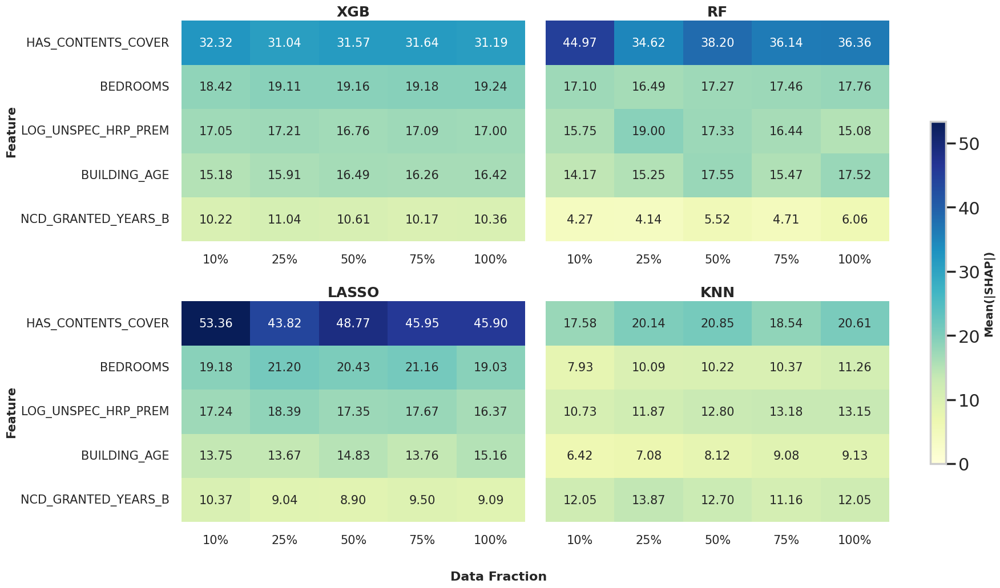

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# ------------------------------------------------------------------
# Loader function for SHAP summaries
# ------------------------------------------------------------------
def load_all_shap(model_name):
    base_dirs = {
        "xgb":   "/content/drive/MyDrive/MSc Research/EXPLAIN",
        "rf":    "/content/drive/MyDrive/MSc Research/Random Forest/Explain",
        "lasso": "/content/drive/MyDrive/MSc Research/Lasso",
        "knn":   "/content/drive/MyDrive/MSc Research/KNN/Explain"
    }
    dfs = []
    for label, frac in zip(["10","25","50","75","100"], [0.10,0.25,0.50,0.75,1.00]):
        path = f"{base_dirs[model_name]}/{model_name}_mean_shap_{label}.csv"
        try:
            df = pd.read_csv(path)
            df["sample_frac"] = frac
            dfs.append(df)
        except FileNotFoundError:
            continue
    return pd.concat(dfs, ignore_index=True) if dfs else pd.DataFrame()

# ------------------------------------------------------------------
# 2×2 Heatmaps (XGB, RF, LASSO, KNN) with shared colorbar
# ------------------------------------------------------------------
def plot_side_by_side_heatmaps(top_k=5, save_path=None):
    models = ["xgb", "rf", "lasso", "knn"]

    # --- Step 1: collect all features
    all_dfs = {m: load_all_shap(m) for m in models}
    combined = pd.concat(all_dfs.values(), ignore_index=True)

    # --- Step 2: global top features
    global_top_feats = (combined.groupby("feature")["mean_abs_shap"]
                          .mean()
                          .sort_values(ascending=False)
                          .head(top_k)
                          .index.tolist())

    # --- Step 3: global min/max for colormap
    vmin = combined["mean_abs_shap"].min()
    vmax = combined["mean_abs_shap"].max()

    # --- Step 4: 2×2 subplot grid
    fig, axes = plt.subplots(2, 2, figsize=(18, 12), sharey=True)
    axes = axes.flatten()

    for ax, model in zip(axes, models):
        df = all_dfs[model]
        if df.empty:
            ax.set_visible(False)
            continue

        df_top = df[df["feature"].isin(global_top_feats)]
        pivot = df_top.pivot_table(index="feature", columns="sample_frac", values="mean_abs_shap")
        pivot = pivot.loc[global_top_feats]

        sns.heatmap(
            pivot, annot=True, fmt=".2f", cmap="YlGnBu",
            cbar=False, ax=ax, vmin=vmin, vmax=vmax,
            annot_kws={"size":15}
        )

        # Format x-axis fractions
        ax.set_xticklabels(["10%","25%","50%","75%","100%"], rotation=0, fontsize=15)
        ax.tick_params(axis='y', labelsize=15)
        ax.set_xlabel("")
        if model in ["xgb", "lasso"]:
            ax.set_ylabel("Feature", fontsize=15)
        else:
            ax.set_ylabel("")

        ax.set_title(model.upper(), fontsize=18, weight="bold")

    # --- Step 5: shared colorbar
    cbar_ax = fig.add_axes([0.92, 0.25, 0.015, 0.5])
    sm = plt.cm.ScalarMappable(cmap="YlGnBu", norm=plt.Normalize(vmin=vmin, vmax=vmax))
    cbar = fig.colorbar(sm, cax=cbar_ax)
    cbar.set_label("Mean(|SHAP|)", fontsize=14)

    # Shared x-axis label
    fig.text(0.5, 0.08, "Data Fraction", ha="center", fontsize=16, weight="bold")

    plt.tight_layout(rect=[0, 0.1, 0.9, 0.95])

    # --- Save as PDF if path given
    if save_path:
        plt.savefig(save_path, format="pdf", dpi=600, bbox_inches="tight")

    plt.show()


# ------------------------------------------------------------------
# Run it (and save to PDF)
# ------------------------------------------------------------------
plot_side_by_side_heatmaps(top_k=5,
                           save_path="/content/drive/MyDrive/MSc Research/heatmaps.pdf")


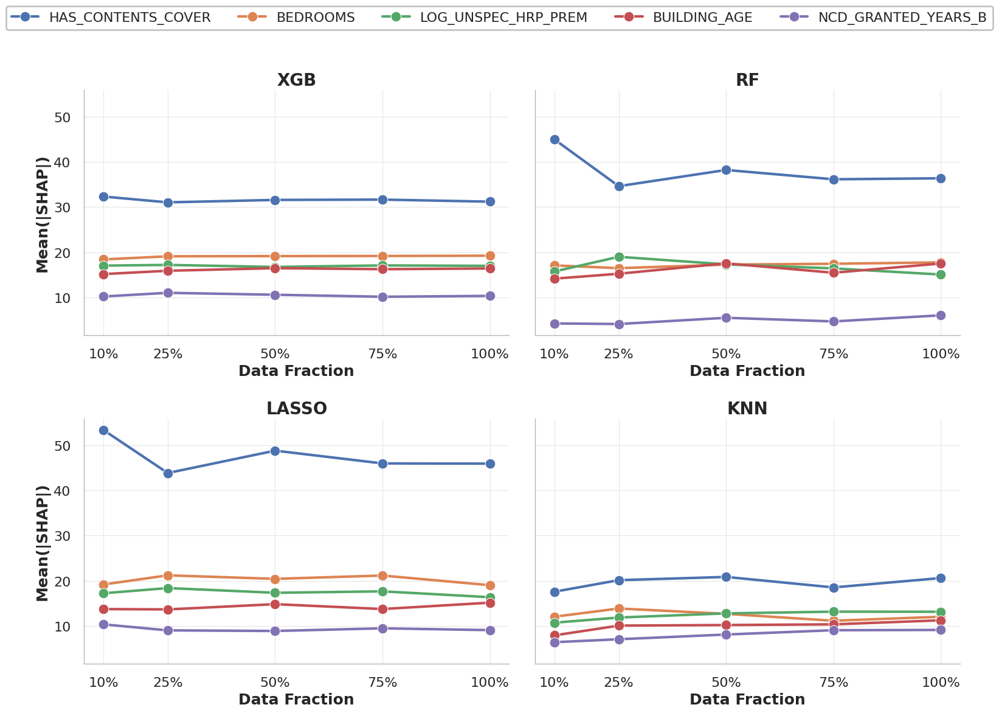

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# ------------------------------------------------------------------
# Loader function for SHAP summaries
# ------------------------------------------------------------------
def load_all_shap(model_name):
    base_dirs = {
        "xgb":   "/content/drive/MyDrive/MSc Research/EXPLAIN",
        "rf":    "/content/drive/MyDrive/MSc Research/Random Forest/Explain",
        "lasso": "/content/drive/MyDrive/MSc Research/Lasso",
        "knn":   "/content/drive/MyDrive/MSc Research/KNN/Explain"
    }
    dfs = []
    for label, frac in zip(["10","25","50","75","100"], [0.10,0.25,0.50,0.75,1.00]):
        path = f"{base_dirs[model_name]}/{model_name}_mean_shap_{label}.csv"
        try:
            df = pd.read_csv(path)
            df["sample_frac"] = frac
            df["model"] = model_name.upper()
            dfs.append(df)
        except FileNotFoundError:
            continue
    return pd.concat(dfs, ignore_index=True) if dfs else pd.DataFrame()

# ------------------------------------------------------------------
# 2×2 Line Plots (XGB, RF, LASSO, KNN) with shared legend
# ------------------------------------------------------------------
def plot_feature_trends_line(top_k=5, save_path=None):
    models = ["xgb", "rf", "lasso", "knn"]

    all_dfs = {m: load_all_shap(m) for m in models}
    combined = pd.concat(all_dfs.values(), ignore_index=True)

    # --- Step 1: select global top-k features
    global_top_feats = (combined.groupby("feature")["mean_abs_shap"]
                          .mean()
                          .sort_values(ascending=False)
                          .head(top_k)
                          .index.tolist())

    # --- Style ---
    sns.set_theme(style="whitegrid", context="poster")
    plt.rcParams.update({
        "axes.titleweight": "bold",
        "axes.labelweight": "semibold",
        "axes.edgecolor": "#B5B5B5",
        "axes.linewidth": 1.0,
        "grid.color": "#E6E6E6",
        "grid.linewidth": 0.8,
        "axes.spines.top": False,
        "axes.spines.right": False,
        "legend.frameon": True,
        "legend.edgecolor": "#B5B5B5",
        "legend.fancybox": True,
        "axes.titlesize": 20,
        "axes.labelsize": 18,
        "xtick.labelsize": 16,
        "ytick.labelsize": 16,
    })

    # --- Step 2: subplot grid
    fig, axes = plt.subplots(2, 2, figsize=(16, 12), sharey=True)
    axes = axes.flatten()

    handles, labels = None, None

    for ax, model in zip(axes, models):
        df = all_dfs[model]
        if df.empty:
            ax.set_visible(False)
            continue

        df_top = df[df["feature"].isin(global_top_feats)]

        # --- Lineplot
        lineplot = sns.lineplot(
            data=df_top, x="sample_frac", y="mean_abs_shap",
            hue="feature", marker="o", lw=3.0, ax=ax
        )

        if handles is None and labels is None:
            handles, labels = lineplot.get_legend_handles_labels()

        ax.get_legend().remove()
        ax.set_title(model.upper(), fontsize=20, weight="bold")
        ax.set_xticks([0.10,0.25,0.50,0.75,1.00])
        ax.set_xticklabels(["10%","25%","50%","75%","100%"])
        ax.set_xlabel("Data Fraction", fontsize=18, weight="semibold")
        ax.set_ylabel("Mean(|SHAP|)", fontsize=18, weight="semibold")

    # --- Shared legend
    fig.legend(handles, labels, loc="upper center", ncol=top_k,
               fontsize=16, frameon=True, fancybox=True)

    plt.tight_layout(rect=[0, 0, 1, 0.93])

    # --- Save as PDF if path given
    if save_path:
        plt.savefig(save_path, format="pdf", dpi=600, bbox_inches="tight")

    plt.show()

# ------------------------------------------------------------------
# Run (with save option)
# ------------------------------------------------------------------
plot_feature_trends_line(top_k=5,
                         save_path="/content/drive/MyDrive/MSc Research/SHAP/feature_trends.pdf")


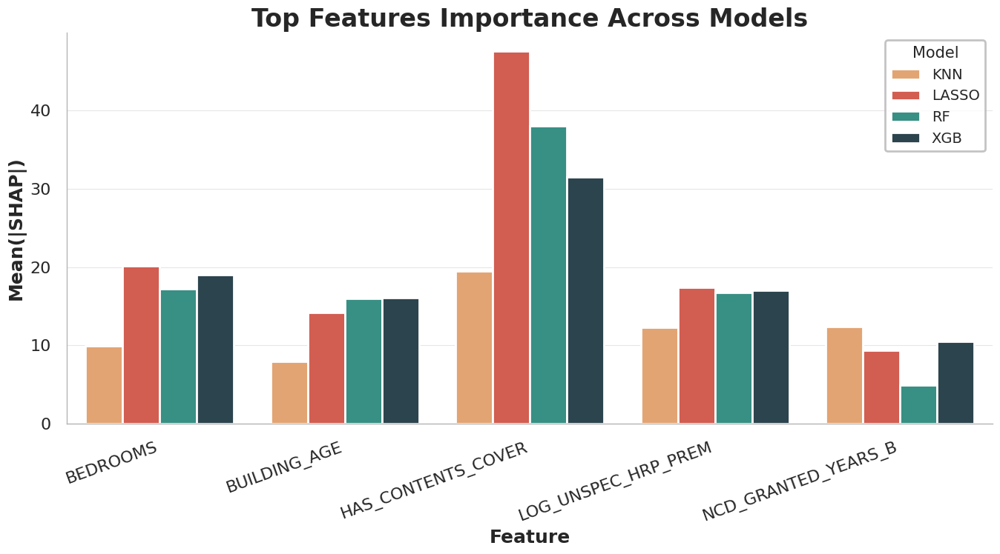

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def plot_grouped_bar(top_k=5):
    models = ["xgb", "rf", "lasso", "knn"]

    # load all data
    all_dfs = []
    for m in models:
        df = load_all_shap(m)
        if not df.empty:
            all_dfs.append(df)
    combined = pd.concat(all_dfs, ignore_index=True)

    # global top-k features across all models
    global_top_feats = (combined.groupby("feature")["mean_abs_shap"]
                          .mean()
                          .sort_values(ascending=False)
                          .head(top_k)
                          .index.tolist())

    # aggregate mean importance per feature per model
    agg = (combined[combined["feature"].isin(global_top_feats)]
             .groupby(["model", "feature"], as_index=False)["mean_abs_shap"]
             .mean())

    # --- Style ---
    sns.set_theme(style="whitegrid", context="poster")
    plt.rcParams.update({
        "axes.titleweight": "bold",
        "axes.labelweight": "semibold",
        "axes.edgecolor": "#B5B5B5",
        "axes.linewidth": 1.0,
        "grid.color": "#E6E6E6",
        "grid.linewidth": 0.8,
        "axes.spines.top": False,
        "axes.spines.right": False,
        "legend.frameon": True,
        "legend.edgecolor": "#B5B5B5",
        "legend.fancybox": True,
        "axes.titlesize": 22,
        "axes.labelsize": 18,
        "xtick.labelsize": 16,
        "ytick.labelsize": 16,
    })

    # Custom palette
    palette = {
    "XGB":   "#264653",  # deep teal
    "RF":    "#2a9d8f",  # sea green
    "LASSO": "#e74c3c",  # sand yellow
    "KNN":   "#f4a261"   # sunset orange
}



    # --- Plot ---
    plt.figure(figsize=(14, 8))
    sns.barplot(
        data=agg, x="feature", y="mean_abs_shap",
        hue="model", palette=palette
    )

    plt.title("Top Features Importance Across Models", fontsize=24, weight="bold")
    plt.xlabel("Feature", fontsize=18, weight="semibold")
    plt.ylabel("Mean(|SHAP|)", fontsize=18, weight="semibold")
    plt.legend(title="Model", fontsize=14, title_fontsize=15, loc="upper right")
    plt.xticks(rotation=20, ha="right")

    plt.tight_layout()
    plt.show()

# Run
plot_grouped_bar(top_k=5)


## **Global Explanations (SHAP)**

### **XGBOOST**


=== Reloading SHAP for 10% sample ===


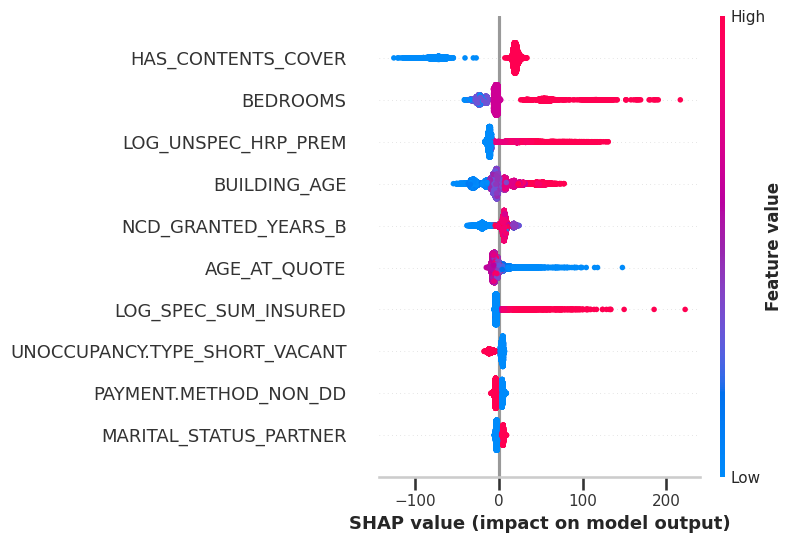


=== Reloading SHAP for 25% sample ===


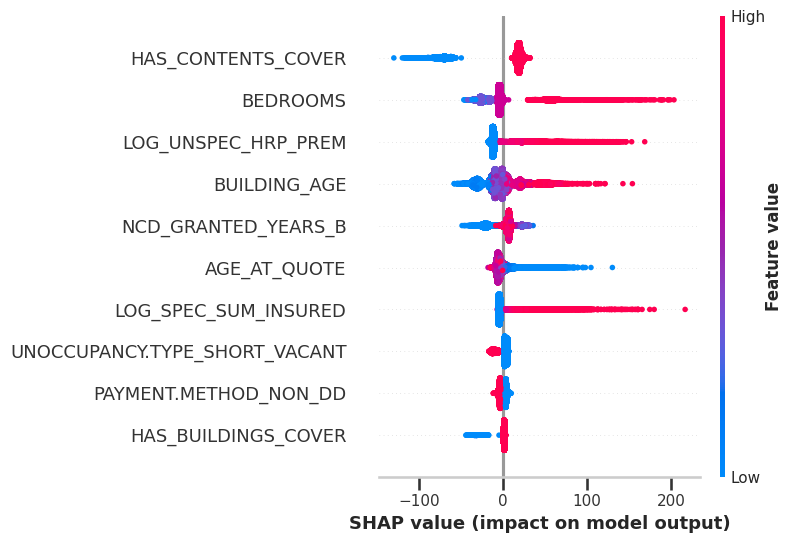


=== Reloading SHAP for 50% sample ===


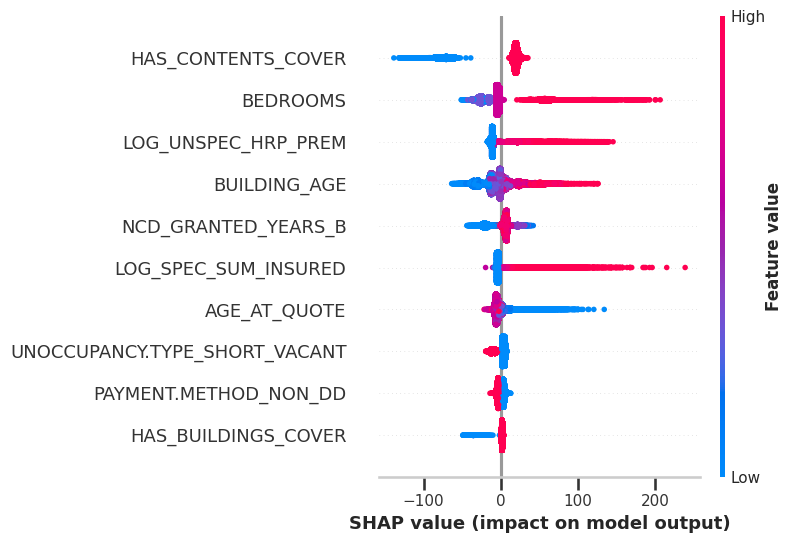


=== Reloading SHAP for 75% sample ===


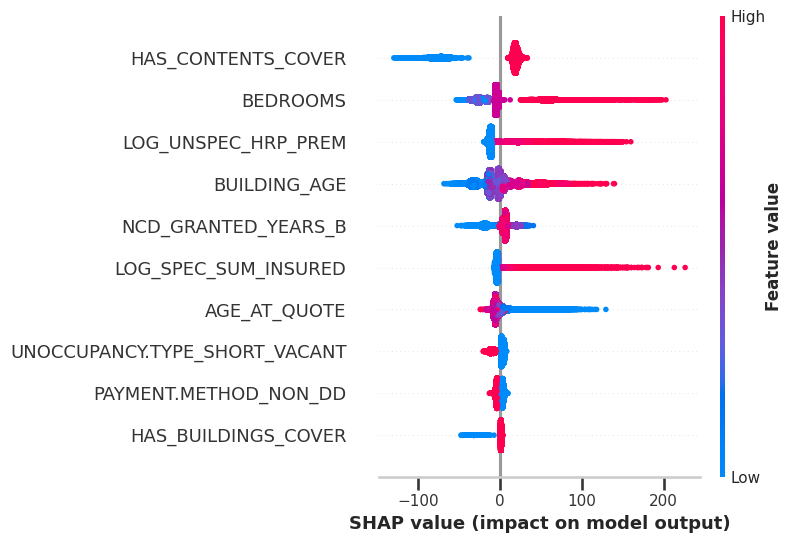

In [ ]:
# ============================================================
# Reload SHAP artifacts and plot summary plots (10–75% only)
# ============================================================
import numpy as np, pandas as pd, shap, matplotlib.pyplot as plt, os

out_dir = "/content/drive/MyDrive/MSc Research/EXPLAIN"

# Reload full dataset
full_df = pd.read_pickle("/content/drive/MyDrive/MSc Research/final_df.pkl")

# Stratified subsample function (same as before)
from sklearn.model_selection import StratifiedShuffleSplit
def stratified_subsample(data, frac=0.1, n_bins=10, random_state=42):
    if frac >= 1.0:
        return data.copy()
    tmp = data.copy()
    tmp["prem_bin"] = pd.qcut(tmp["PREMIUM"], q=n_bins, labels=False, duplicates="drop")
    splitter = StratifiedShuffleSplit(n_splits=1, test_size=frac, random_state=random_state)
    idx = next(splitter.split(tmp, tmp["prem_bin"]))[1]
    return tmp.iloc[idx].drop(columns=["prem_bin"])

labels_fracs = [("10", 0.10), ("25", 0.25), ("50", 0.50), ("75", 0.75)]

# Loop through each
for lab, frac in labels_fracs:
    print(f"\n=== Reloading SHAP for {lab}% sample ===")

    # Load npz file
    npz = np.load(f"{out_dir}/xgb_shap_values_{lab}.npz", allow_pickle=True)
    shap_vals   = npz["shap_values"]
    feat_names  = npz["feature_names"].astype(str)

    # Recreate subsample (only needed for beeswarm coloring)
    X_full = stratified_subsample(full_df, frac=frac).drop(columns=["PREMIUM"])

    # --- Beeswarm plot ---
    plt.close('all')
    plt.rcParams["axes.grid"] = False
    shap.summary_plot(shap_vals, X_full, feature_names=feat_names, max_display=10, show=False)
    plt.tight_layout()
    plt.show()



=== Plotting SHAP bar plot for 10% sample ===


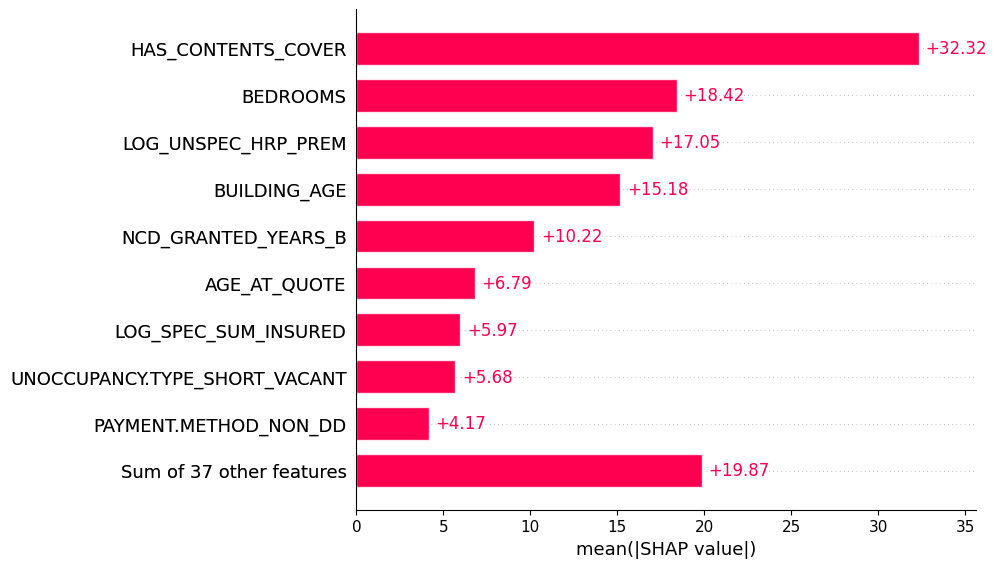


=== Plotting SHAP bar plot for 25% sample ===


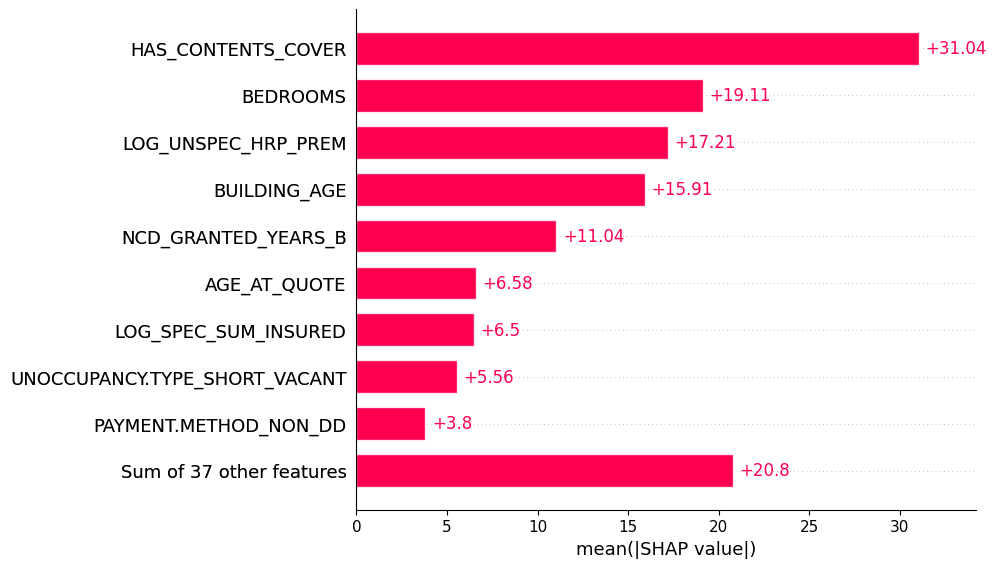


=== Plotting SHAP bar plot for 50% sample ===


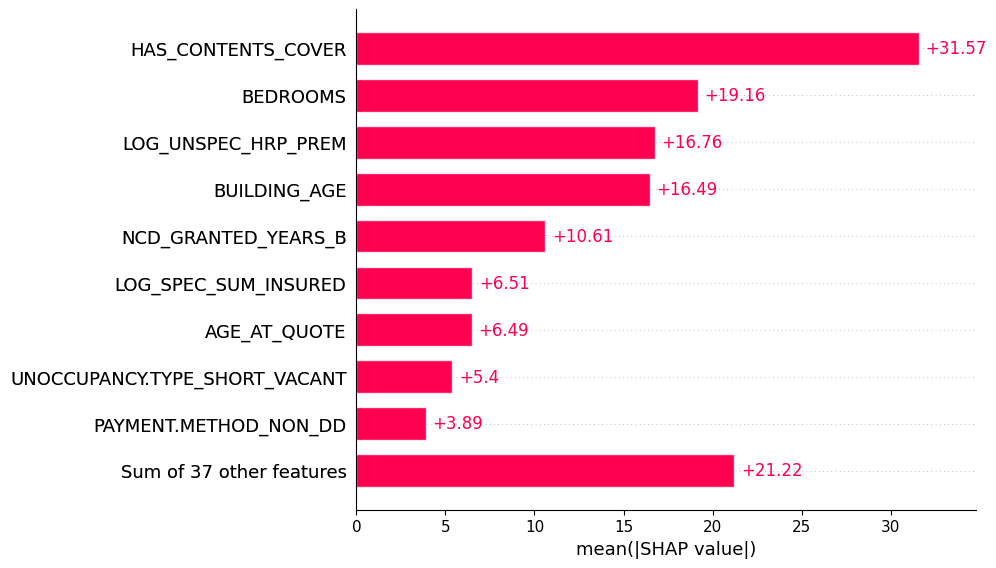


=== Plotting SHAP bar plot for 75% sample ===


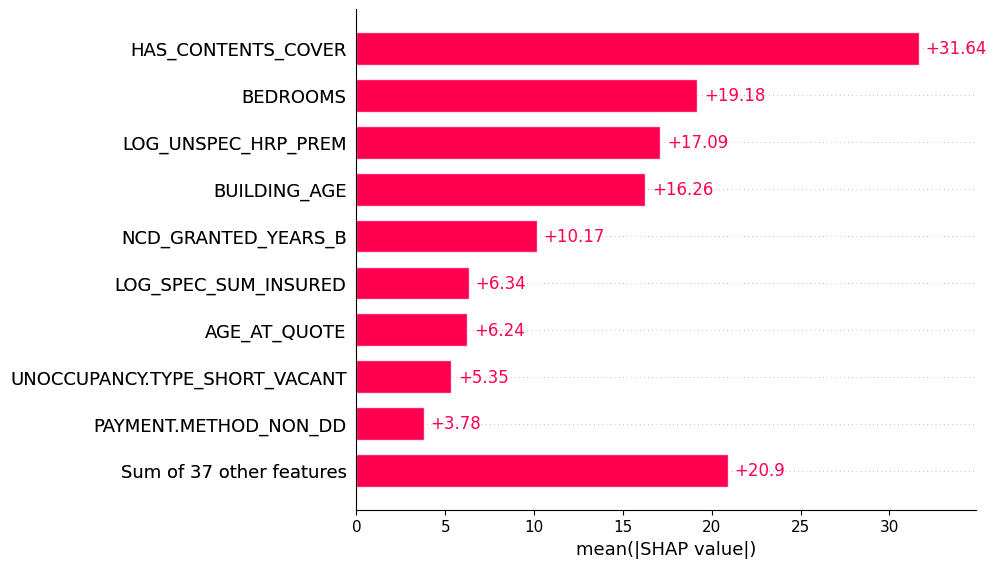


=== Plotting SHAP bar plot for 100% sample ===


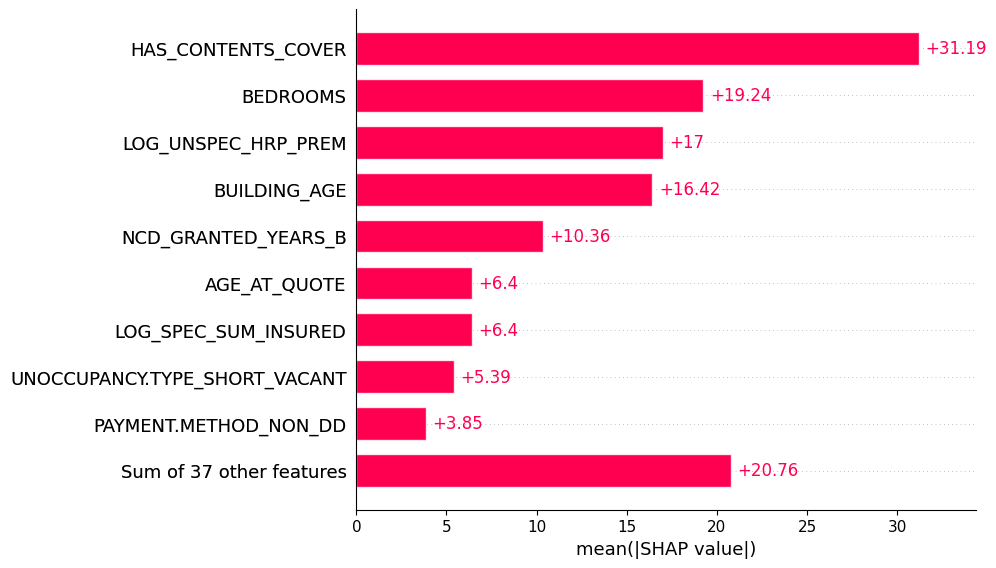

In [ ]:
# ============================================================
# Reload SHAP artifacts and plot bar plots (10–75%)
# ============================================================
import numpy as np
import pandas as pd
import shap
import matplotlib.pyplot as plt
import os

# Output directory
out_dir = "/content/drive/MyDrive/MSc Research/EXPLAIN"

# Define sample labels and fractions
labels_fracs = [("10", 0.10), ("25", 0.25), ("50", 0.50), ("75", 0.75), ("100", 1.00)]

# Loop through each subsample level
for lab, frac in labels_fracs:
    print(f"\n=== Plotting SHAP bar plot for {lab}% sample ===")

    # Load SHAP .npz file
    npz = np.load(f"{out_dir}/xgb_shap_values_{lab}.npz", allow_pickle=True)
    shap_vals  = npz["shap_values"]
    feat_names = npz["feature_names"].astype(str)

    # Wrap into shap.Explanation object
    shap_exp = shap.Explanation(
        values=shap_vals,
        feature_names=feat_names
    )

    shap.plots.bar(shap_exp, max_display=10)


### **Random Forest**


=== Reloading RF SHAP for 10% sample ===


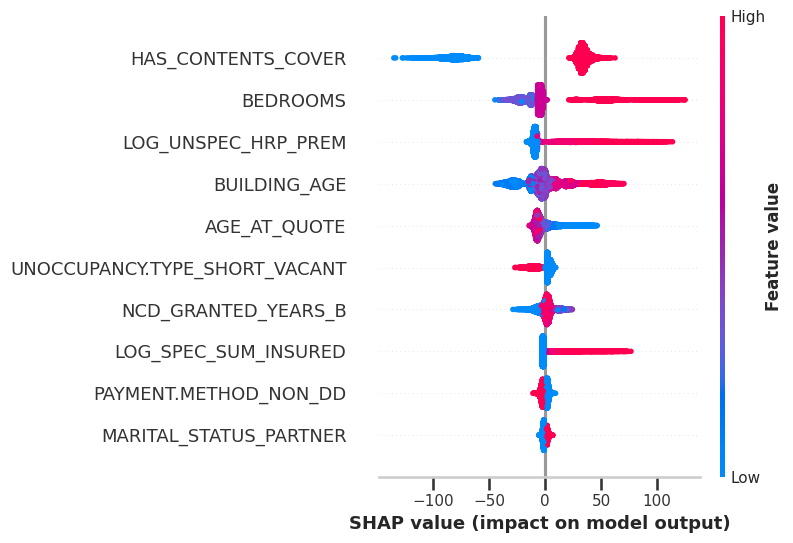


=== Reloading RF SHAP for 25% sample ===


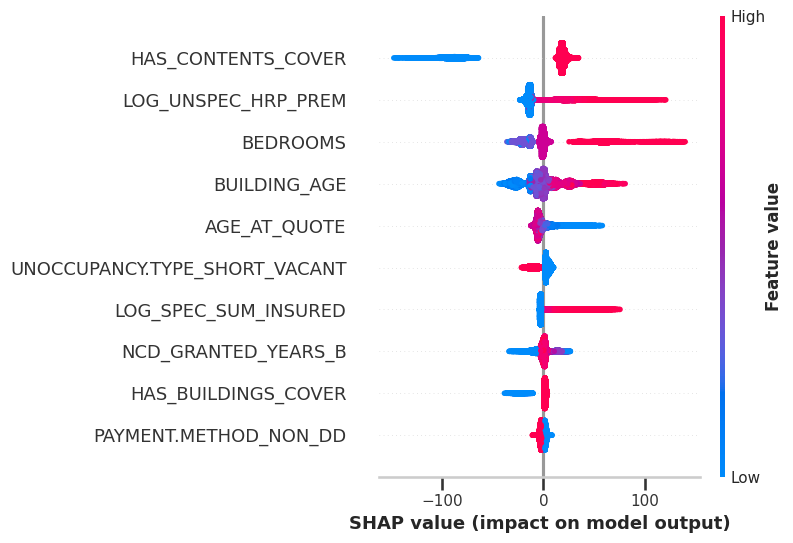


=== Reloading RF SHAP for 50% sample ===


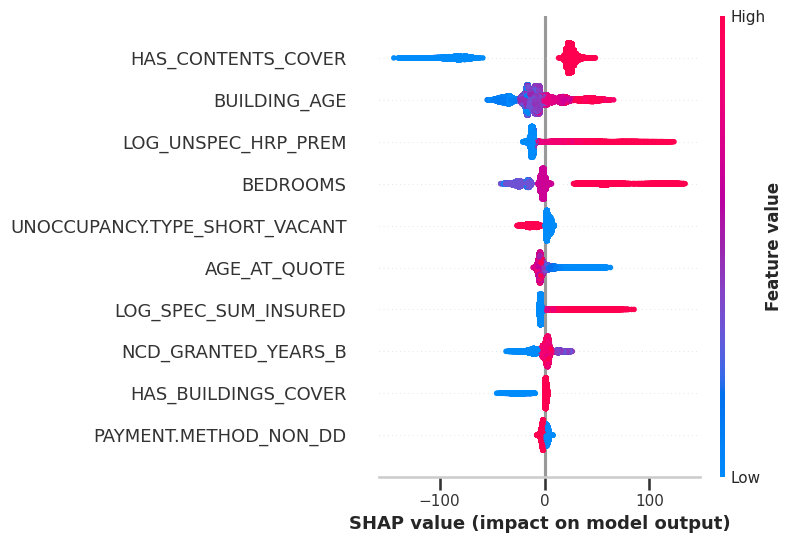


=== Reloading RF SHAP for 75% sample ===


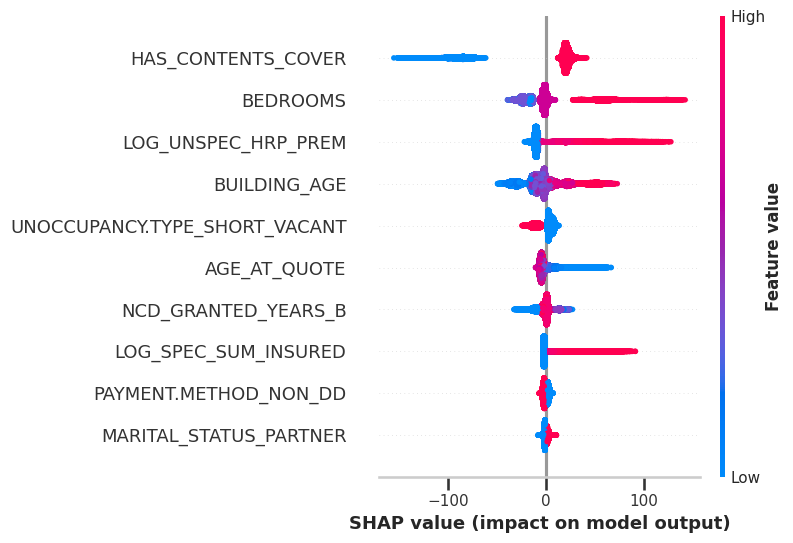


=== Reloading RF SHAP for 100% sample ===


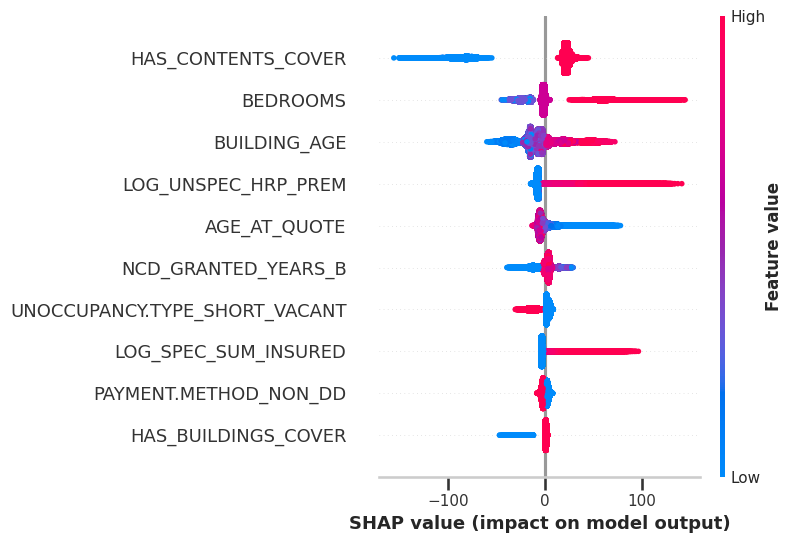

In [ ]:
# ============================================================
# Reload RF SHAP artifacts and plot summary plots (10–75%)
# ============================================================
import numpy as np, pandas as pd, shap, matplotlib.pyplot as plt, os

out_dir = "/content/drive/MyDrive/MSc Research/Random Forest/Explain"

# Reload full dataset
full_df = pd.read_pickle("/content/drive/MyDrive/MSc Research/final_df.pkl")

# Stratified subsample function (same as before)
from sklearn.model_selection import StratifiedShuffleSplit
def stratified_subsample(data, frac=0.1, n_bins=10, random_state=42):
    if frac >= 1.0:
        return data.copy()
    tmp = data.copy()
    tmp["prem_bin"] = pd.qcut(tmp["PREMIUM"], q=n_bins, labels=False, duplicates="drop")
    splitter = StratifiedShuffleSplit(n_splits=1, test_size=frac, random_state=random_state)
    idx = next(splitter.split(tmp, tmp["prem_bin"]))[1]
    return tmp.iloc[idx].drop(columns=["prem_bin"])

# Fractions + labels (skip 100% for now)
labels_fracs = [("10", 0.10), ("25", 0.25), ("50", 0.50), ("75", 0.75),  ("100", 1.00)]

# Loop through each
for lab, frac in labels_fracs:
    print(f"\n=== Reloading RF SHAP for {lab}% sample ===")

    # Load npz file
    npz = np.load(f"{out_dir}/rf_shap_values_{lab}.npz", allow_pickle=True)
    shap_vals   = npz["shap_values"]
    feat_names  = npz["feature_names"].astype(str)

    # Recreate subsample for beeswarm coloring
    X_full = stratified_subsample(full_df, frac=frac).drop(columns=["PREMIUM"])

    # --- Beeswarm plot ---
    plt.close('all')
    plt.rcParams["axes.grid"] = False
    shap.summary_plot(shap_vals, X_full, feature_names=feat_names, max_display=10, show=False)
    plt.tight_layout()
    plt.show()


=== Plotting RF SHAP bar plot for 10% sample ===


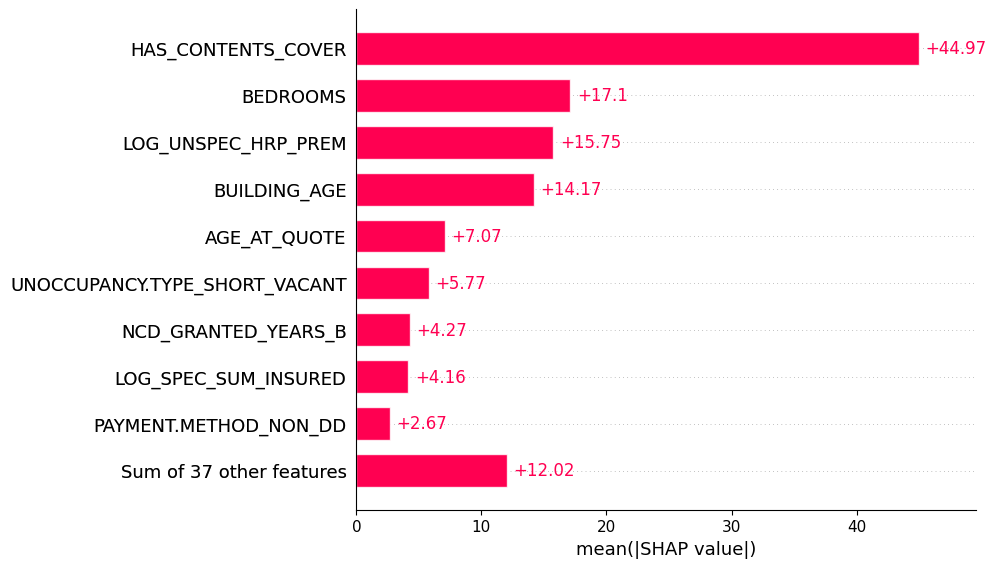


=== Plotting RF SHAP bar plot for 25% sample ===


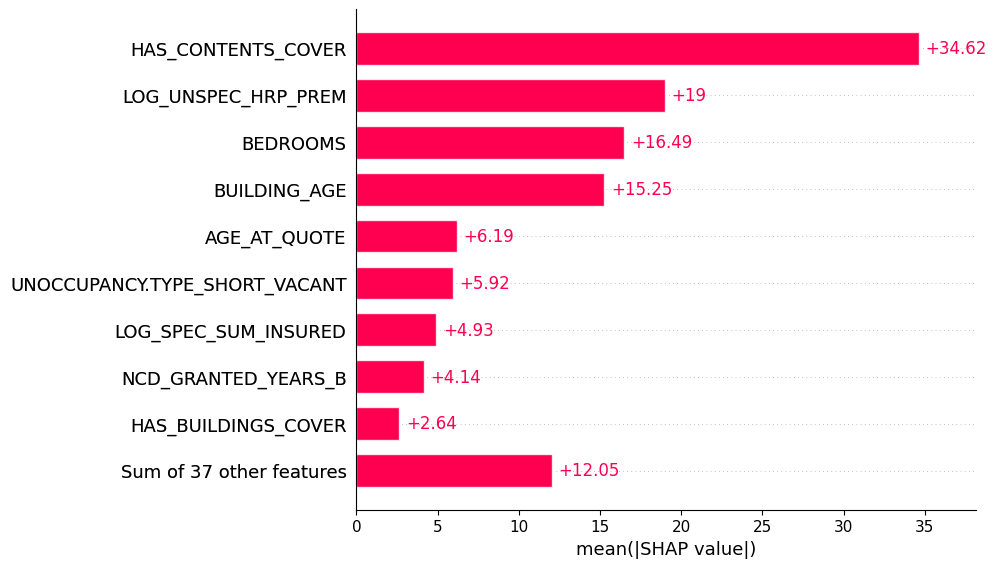


=== Plotting RF SHAP bar plot for 50% sample ===


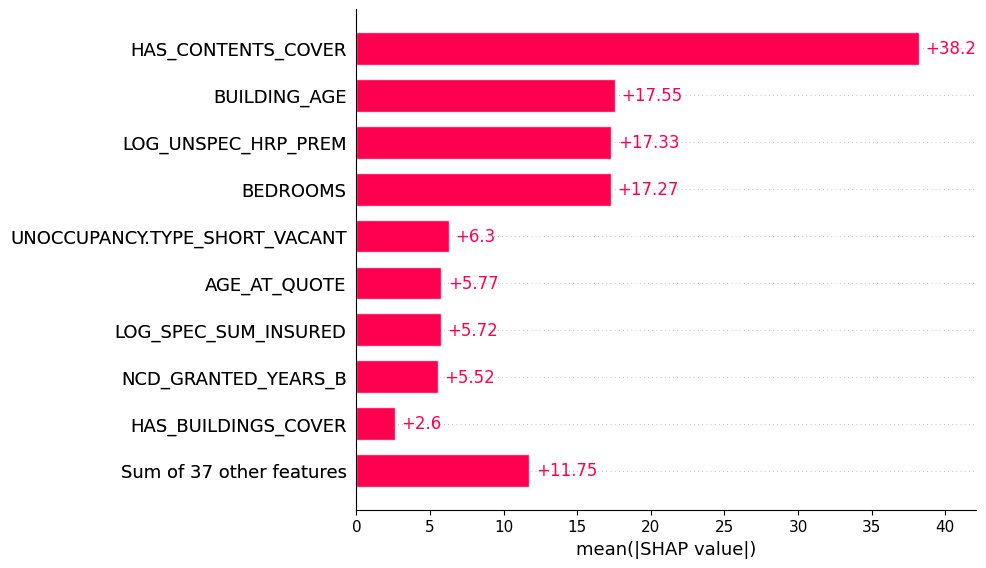


=== Plotting RF SHAP bar plot for 75% sample ===


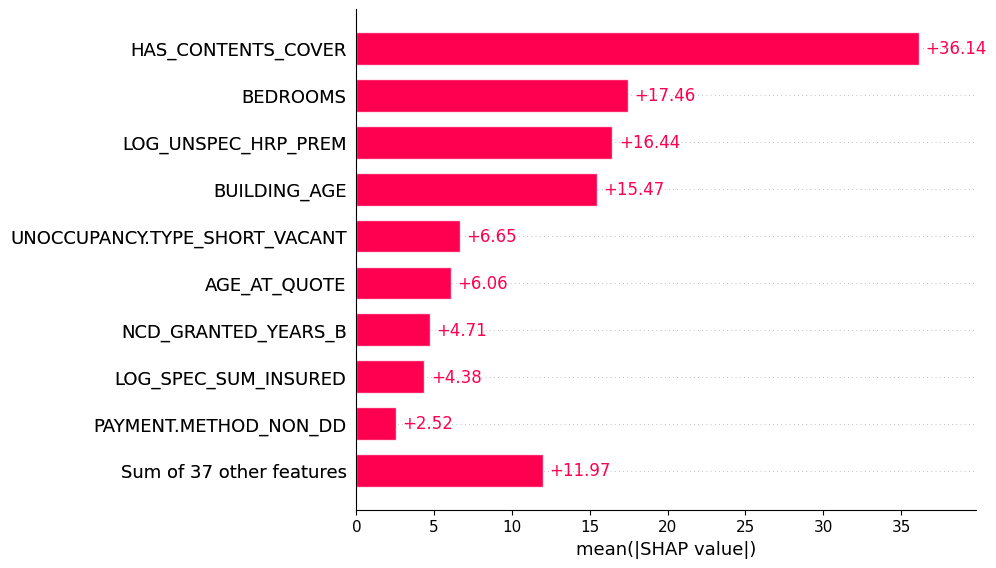


=== Plotting RF SHAP bar plot for 100% sample ===


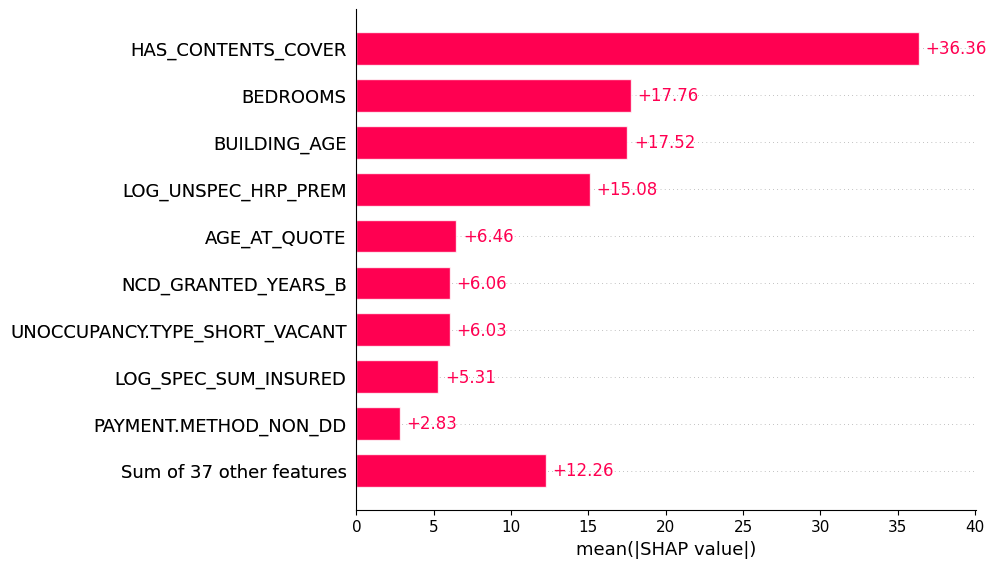

In [ ]:
# ============================================================
# Reload RF SHAP artifacts and plot bar plots (10–100%)
# ============================================================
import numpy as np
import shap

out_dir = "/content/drive/MyDrive/MSc Research/Random Forest/Explain"

# Fractions + labels
labels_fracs = [("10", 0.10), ("25", 0.25), ("50", 0.50), ("75", 0.75), ("100", 1.00)]

# Loop through each subset
for lab, frac in labels_fracs:
    print(f"\n=== Plotting RF SHAP bar plot for {lab}% sample ===")

    # Load stored SHAP artifacts
    npz = np.load(f"{out_dir}/rf_shap_values_{lab}.npz", allow_pickle=True)
    shap_vals  = npz["shap_values"]
    feat_names = npz["feature_names"].astype(str)

    # Create SHAP Explanation object
    shap_exp = shap.Explanation(
        values=shap_vals,
        feature_names=feat_names
    )

    # Plot bar chart (top 10 features)
    shap.plots.bar(shap_exp, max_display=10)


### **LASSO**


=== Reloading Lasso SHAP for 10% sample ===


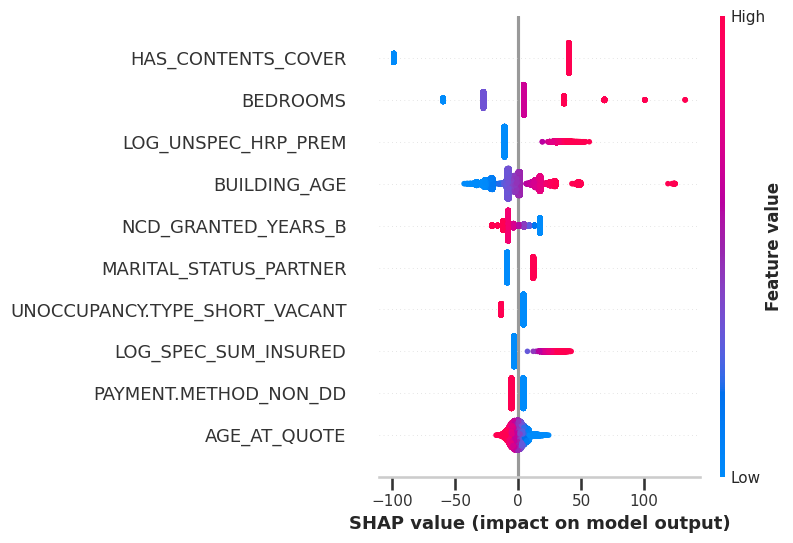


=== Reloading Lasso SHAP for 25% sample ===


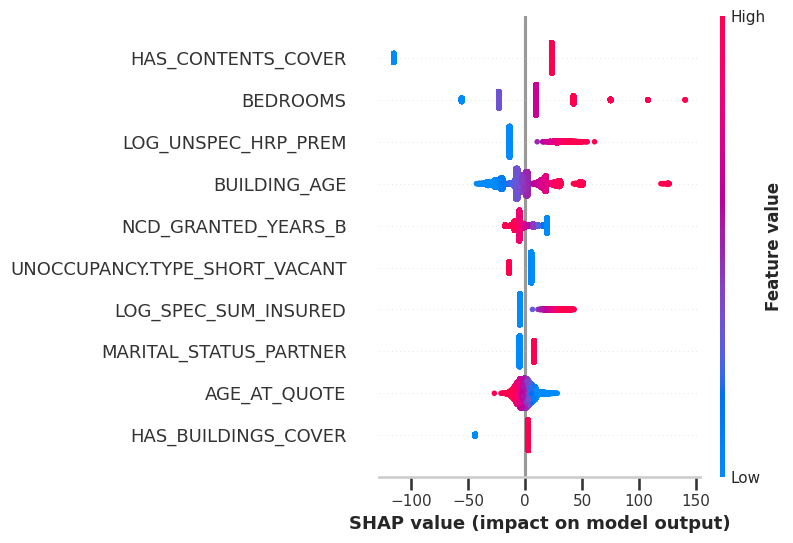


=== Reloading Lasso SHAP for 50% sample ===


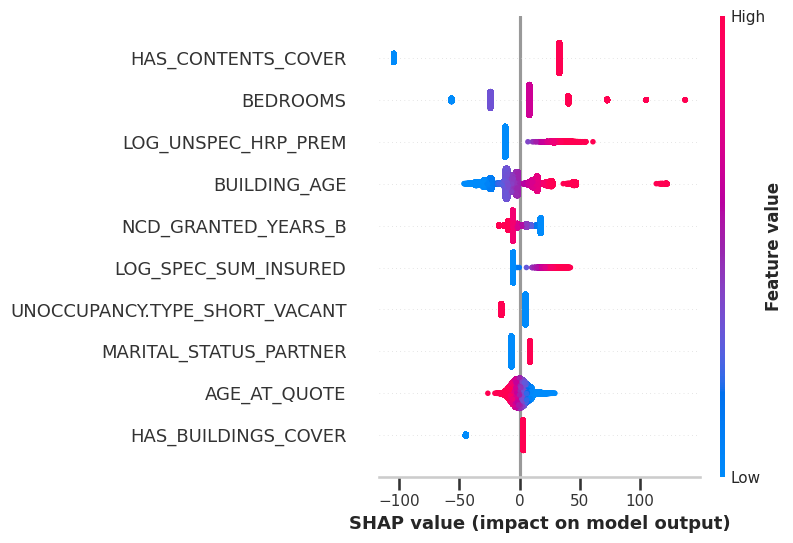


=== Reloading Lasso SHAP for 75% sample ===


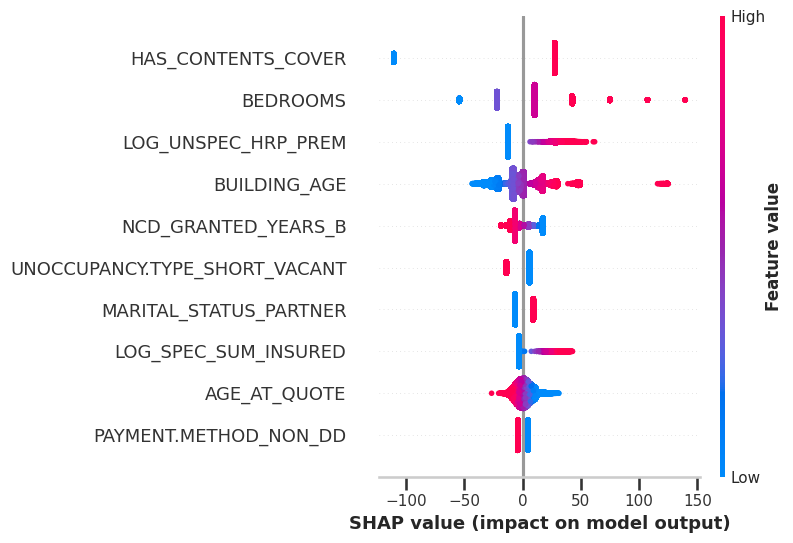


=== Reloading Lasso SHAP for 100% sample ===


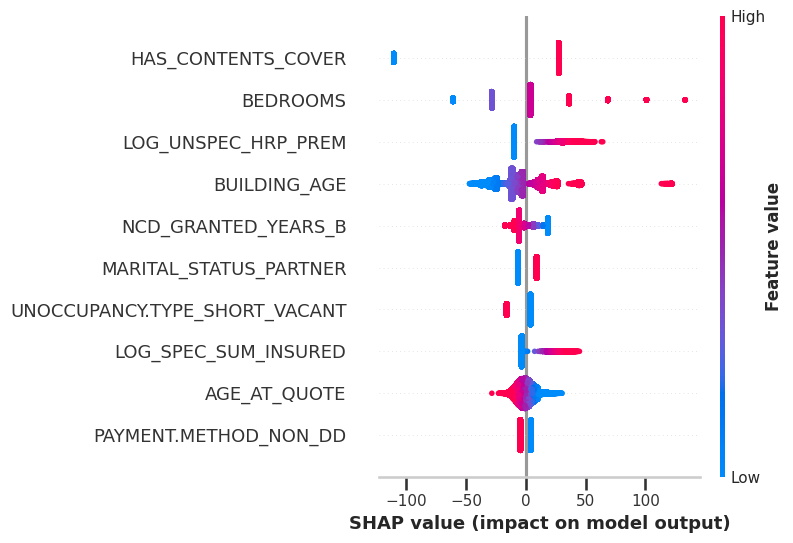

In [ ]:
# ============================================================
# Reload Lasso SHAP artifacts and plot summary plots (10–75%)
# ============================================================
import numpy as np, pandas as pd, shap, matplotlib.pyplot as plt, os

out_dir = "/content/drive/MyDrive/MSc Research/Lasso"

# Reload full dataset
full_df = pd.read_pickle("/content/drive/MyDrive/MSc Research/final_df.pkl")

# Stratified subsample function (same as before)
from sklearn.model_selection import StratifiedShuffleSplit
def stratified_subsample(data, frac=0.1, n_bins=10, random_state=42):
    if frac >= 1.0:
        return data.copy()
    tmp = data.copy()
    tmp["prem_bin"] = pd.qcut(tmp["PREMIUM"], q=n_bins, labels=False, duplicates="drop")
    splitter = StratifiedShuffleSplit(n_splits=1, test_size=frac, random_state=random_state)
    idx = next(splitter.split(tmp, tmp["prem_bin"]))[1]
    return tmp.iloc[idx].drop(columns=["prem_bin"])

# Fractions + labels (skip 100%)
labels_fracs = [("10", 0.10), ("25", 0.25), ("50", 0.50), ("75", 0.75),  ("100", 1.00)]

# Loop through each
for lab, frac in labels_fracs:
    print(f"\n=== Reloading Lasso SHAP for {lab}% sample ===")

    # Load npz file
    npz = np.load(f"{out_dir}/lasso_shap_values_{lab}.npz", allow_pickle=True)
    shap_vals   = npz["shap_values"]
    feat_names  = npz["feature_names"].astype(str)

    # Recreate subsample for beeswarm coloring
    X_full = stratified_subsample(full_df, frac=frac).drop(columns=["PREMIUM"])

    # --- Beeswarm plot ---
    plt.close('all')
    shap.summary_plot(shap_vals, X_full, feature_names=feat_names, max_display=10, show=False)
    plt.tight_layout()
    plt.show()



=== Plotting Lasso SHAP bar plot for 10% sample ===


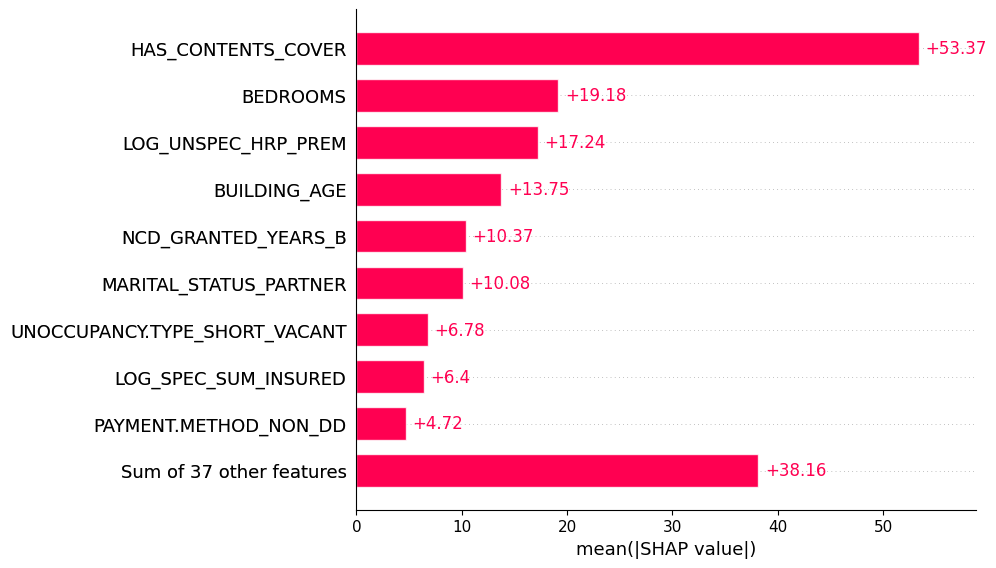


=== Plotting Lasso SHAP bar plot for 25% sample ===


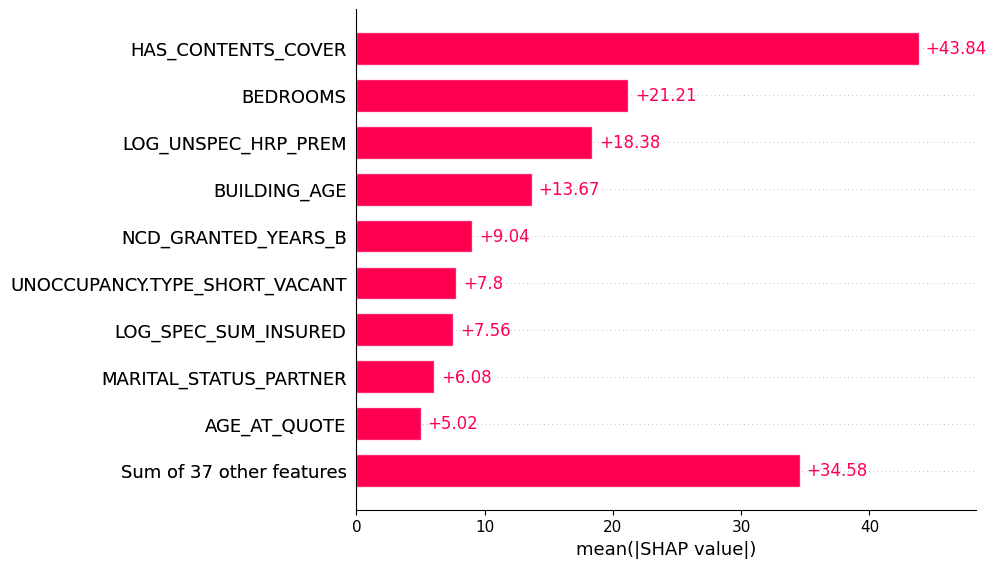


=== Plotting Lasso SHAP bar plot for 50% sample ===


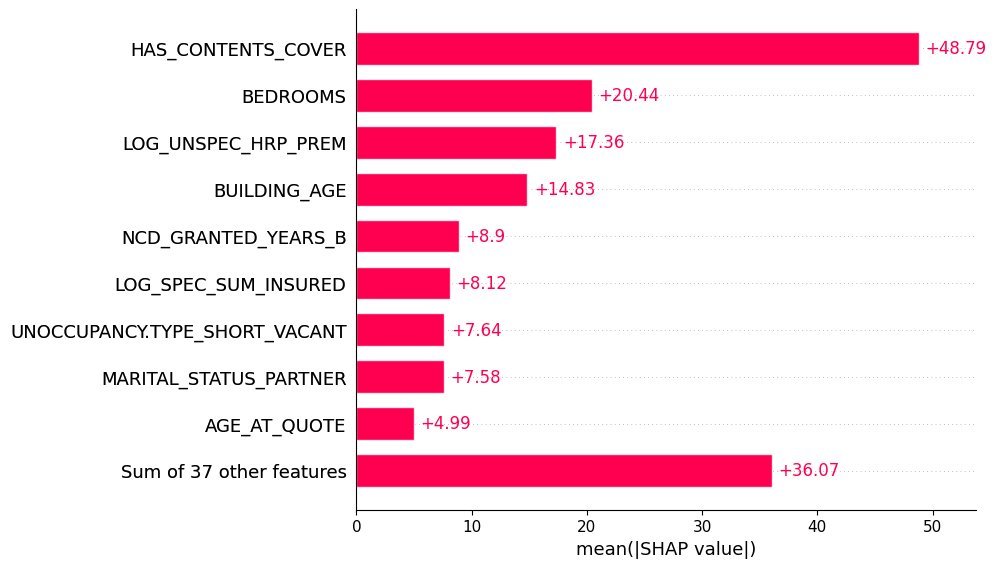


=== Plotting Lasso SHAP bar plot for 75% sample ===


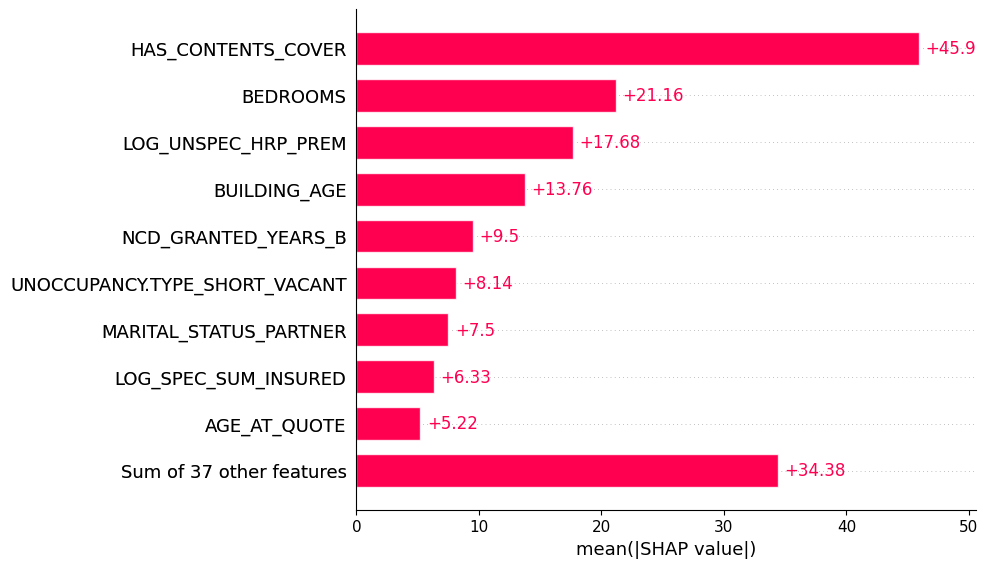


=== Plotting Lasso SHAP bar plot for 100% sample ===


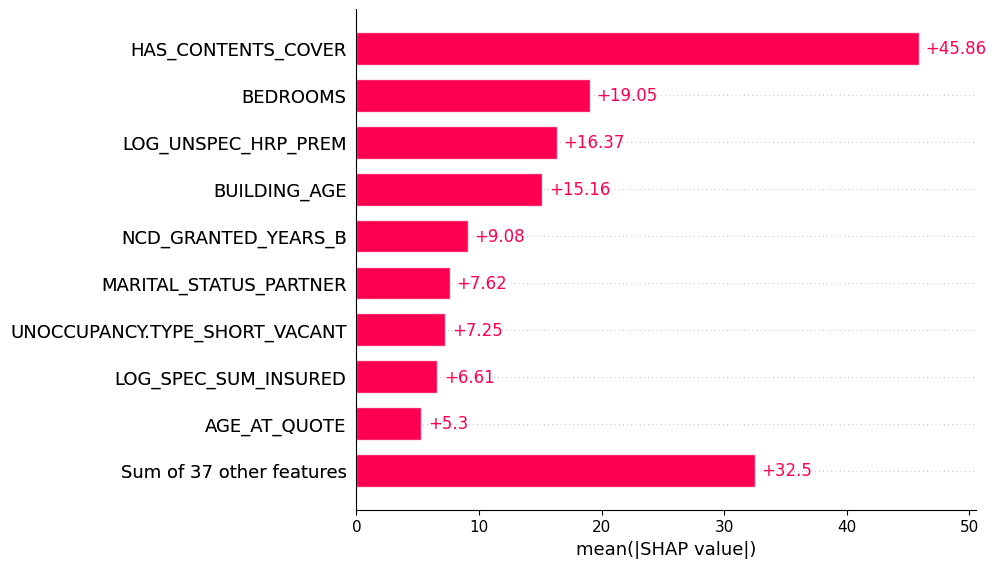

In [ ]:
# ============================================================
# Reload Lasso SHAP artifacts and plot bar plots (10–100%)
# ============================================================
import numpy as np
import shap

out_dir = "/content/drive/MyDrive/MSc Research/Lasso"

# Fractions + labels
labels_fracs = [("10", 0.10), ("25", 0.25), ("50", 0.50), ("75", 0.75), ("100", 1.00)]

# Loop through each subset
for lab, frac in labels_fracs:
    print(f"\n=== Plotting Lasso SHAP bar plot for {lab}% sample ===")

    # Load stored SHAP artifacts
    npz = np.load(f"{out_dir}/lasso_shap_values_{lab}.npz", allow_pickle=True)
    shap_vals  = npz["shap_values"]
    feat_names = npz["feature_names"].astype(str)

    # Create SHAP Explanation object
    shap_exp = shap.Explanation(
        values=shap_vals,
        feature_names=feat_names
    )

    # Plot bar chart (top 10 features)
    shap.plots.bar(shap_exp, max_display=10)


### **K-Nearest Neighbours**


=== Reloading KNN SHAP for 10% sample ===
→ Expected rows: 2000, SHAP shape: (2000, 46)


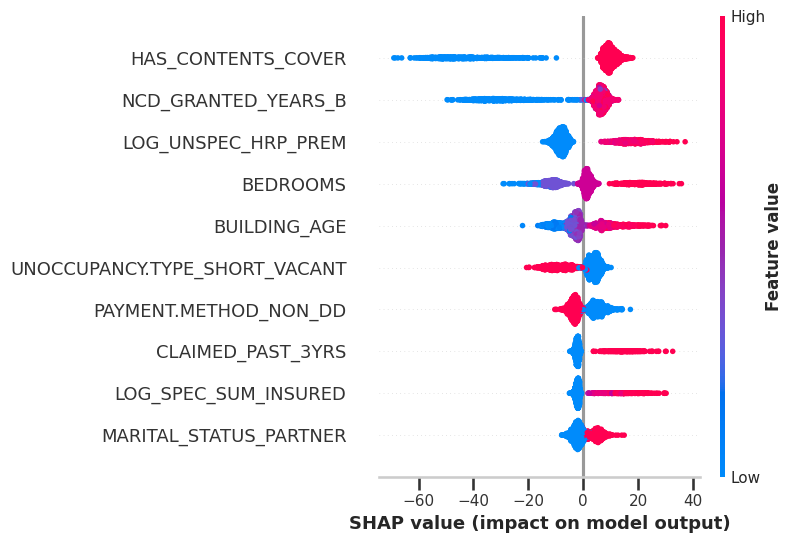


=== Reloading KNN SHAP for 25% sample ===
→ Expected rows: 2000, SHAP shape: (2000, 46)


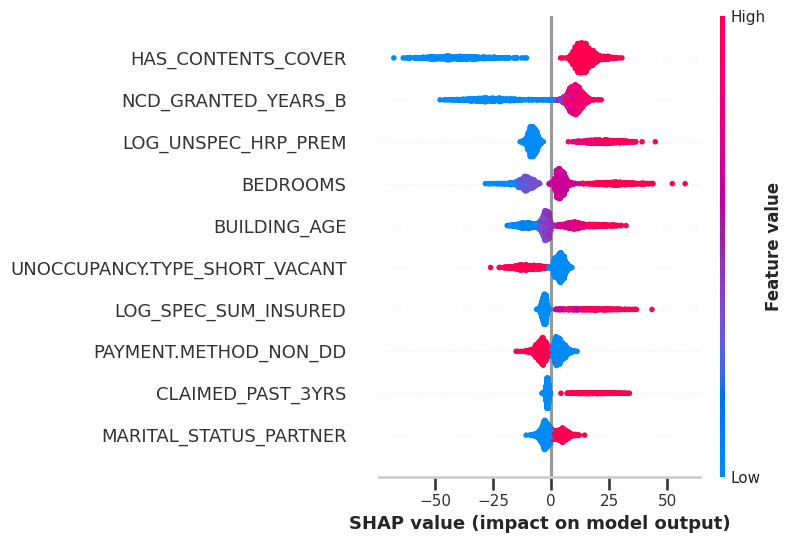


=== Reloading KNN SHAP for 50% sample ===
→ Expected rows: 2000, SHAP shape: (2000, 46)


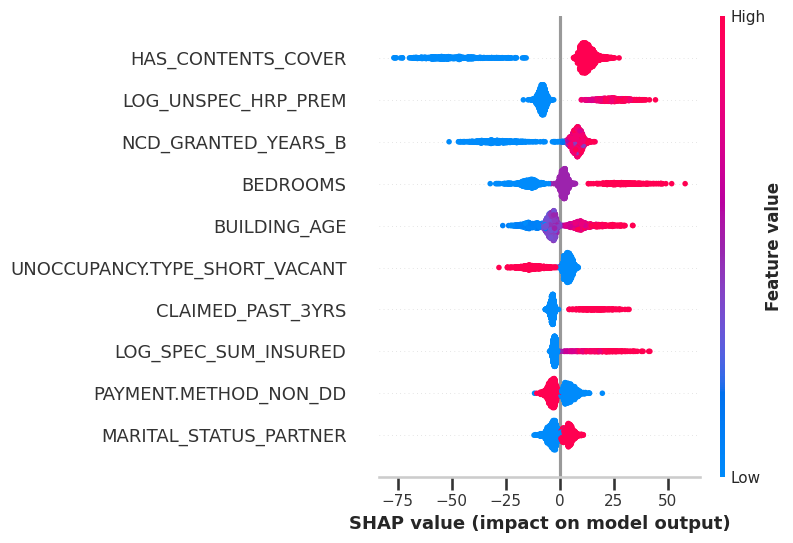


=== Reloading KNN SHAP for 75% sample ===
→ Expected rows: 1000, SHAP shape: (1000, 46)


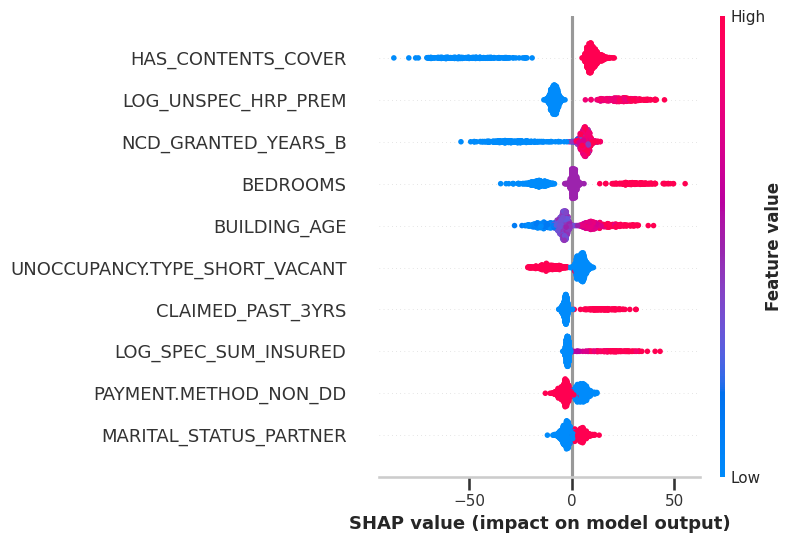


=== Reloading KNN SHAP for 100% sample ===
→ Expected rows: 1000, SHAP shape: (1000, 46)


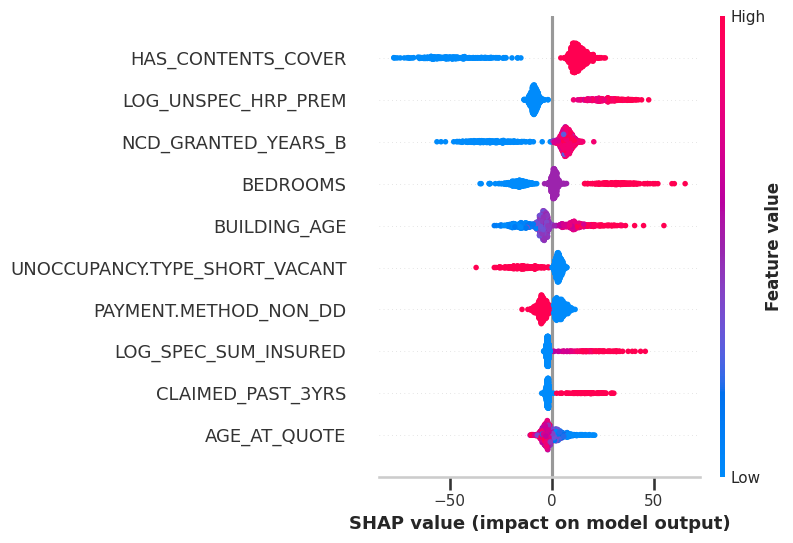

In [ ]:
# ============================================================
# Reload KNN SHAP artifacts and plot summary plots (10–75%)
# with automatic n_rows alignment from meta.json
# ============================================================
import numpy as np, pandas as pd, shap, matplotlib.pyplot as plt, os, json

out_dir = "/content/drive/MyDrive/MSc Research/KNN/Explain"

# Reload full dataset
full_df = pd.read_pickle("/content/drive/MyDrive/MSc Research/final_df.pkl")

# Stratified subsample function (same as before)
from sklearn.model_selection import StratifiedShuffleSplit
def stratified_subsample(data, frac=0.1, n_bins=10, random_state=42):
    if frac >= 1.0:
        return data.copy()
    tmp = data.copy()
    tmp["prem_bin"] = pd.qcut(tmp["PREMIUM"], q=n_bins, labels=False, duplicates="drop")
    splitter = StratifiedShuffleSplit(n_splits=1, test_size=frac, random_state=random_state)
    idx = next(splitter.split(tmp, tmp["prem_bin"]))[1]
    return tmp.iloc[idx].drop(columns=["prem_bin"])

# Fractions + labels (skip 100% if not aligned yet)
labels_fracs = [("10", 0.10), ("25", 0.25), ("50", 0.50), ("75", 0.75),  ("100", 1.00)]

# Loop through each
for lab, frac in labels_fracs:
    print(f"\n=== Reloading KNN SHAP for {lab}% sample ===")

    # Load SHAP values
    npz = np.load(f"{out_dir}/knn_shap_values_{lab}.npz", allow_pickle=True)
    shap_vals  = npz["shap_values"]
    feat_names = npz["feature_names"].astype(str)

    # Load meta to get actual n_rows used
    with open(f"{out_dir}/knn_shap_meta_{lab}.json") as f:
        meta = json.load(f)
    n_rows = meta["n_rows"]
    print(f"→ Expected rows: {n_rows}, SHAP shape: {shap_vals.shape}")

    # Recreate subsample then enforce correct size
    X_full = stratified_subsample(full_df, frac=frac).drop(columns=["PREMIUM"])
    if len(X_full) > n_rows:
        X_full = X_full.sample(n=n_rows, random_state=42)

    # --- Beeswarm plot ---
    plt.close('all')
    shap.summary_plot(shap_vals, X_full, feature_names=feat_names, max_display=10, show=False)
    plt.tight_layout()
    plt.show()



=== Plotting KNN SHAP bar plot for 10% sample ===
→ Expected rows (meta): 2000, SHAP shape: (2000, 46)


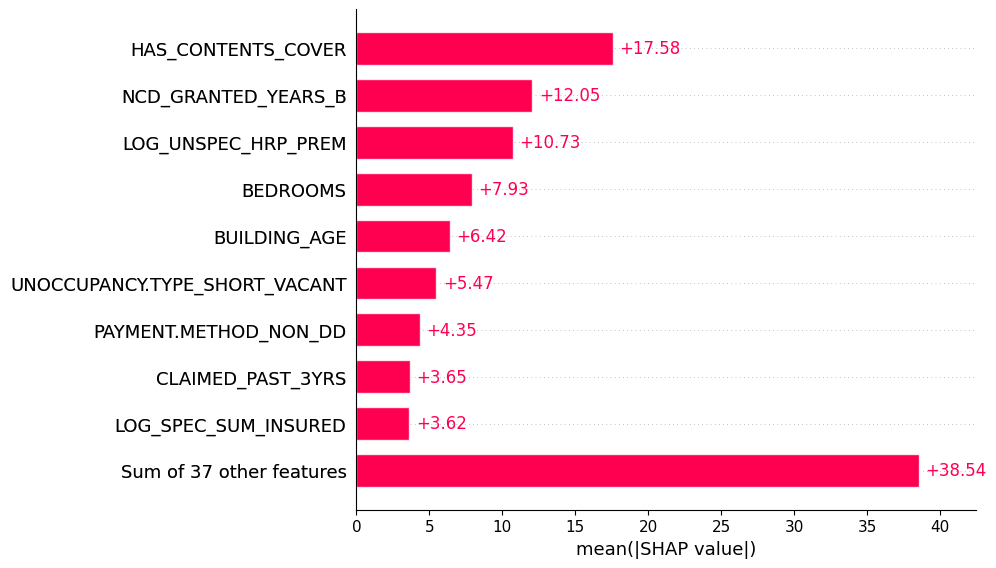


=== Plotting KNN SHAP bar plot for 25% sample ===
→ Expected rows (meta): 2000, SHAP shape: (2000, 46)


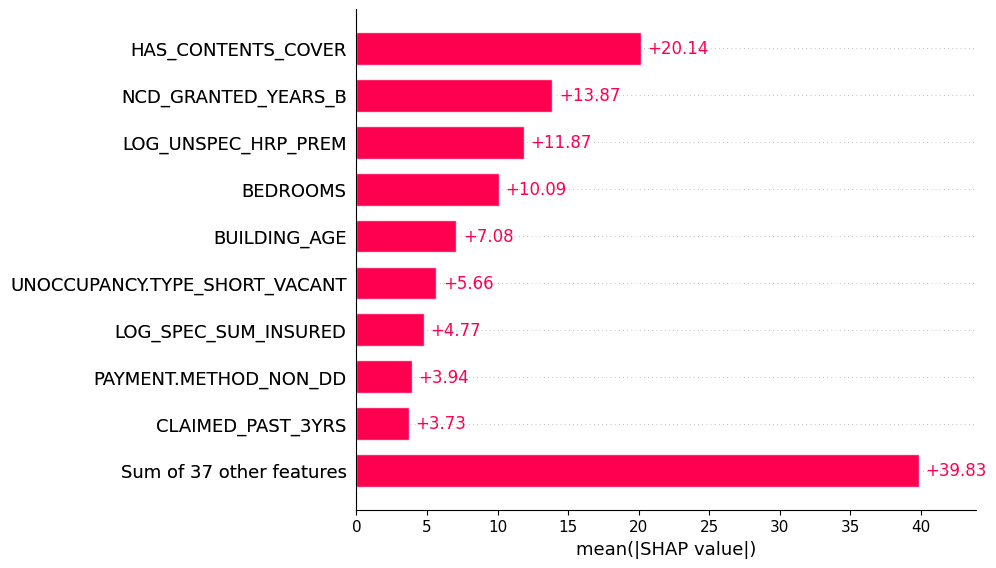


=== Plotting KNN SHAP bar plot for 50% sample ===
→ Expected rows (meta): 2000, SHAP shape: (2000, 46)


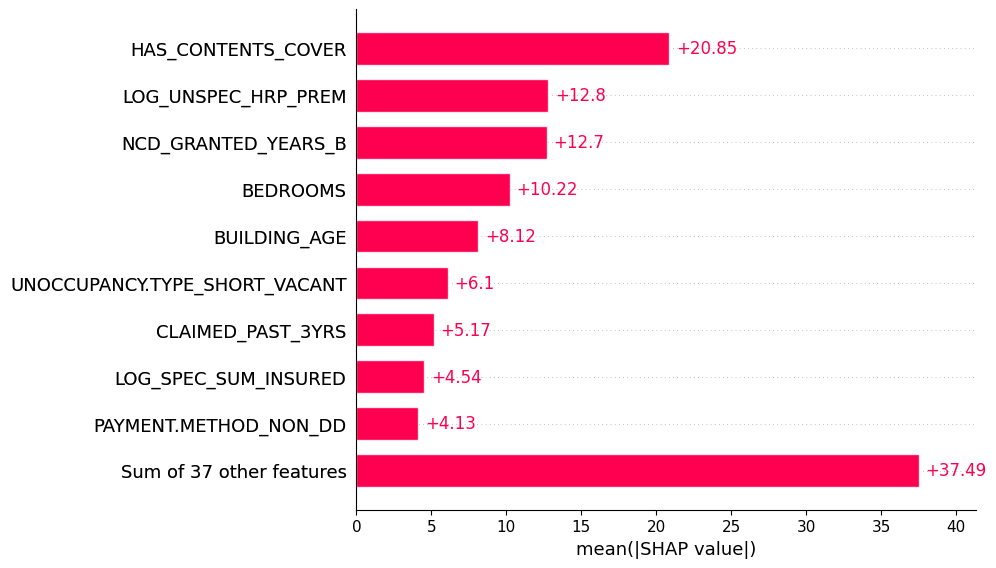


=== Plotting KNN SHAP bar plot for 75% sample ===
→ Expected rows (meta): 1000, SHAP shape: (1000, 46)


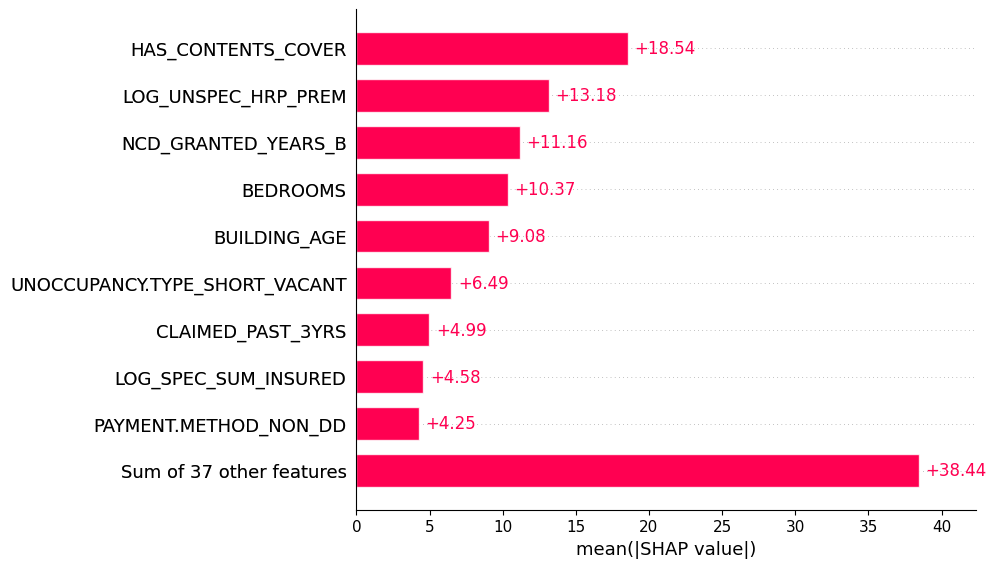


=== Plotting KNN SHAP bar plot for 100% sample ===
→ Expected rows (meta): 1000, SHAP shape: (1000, 46)


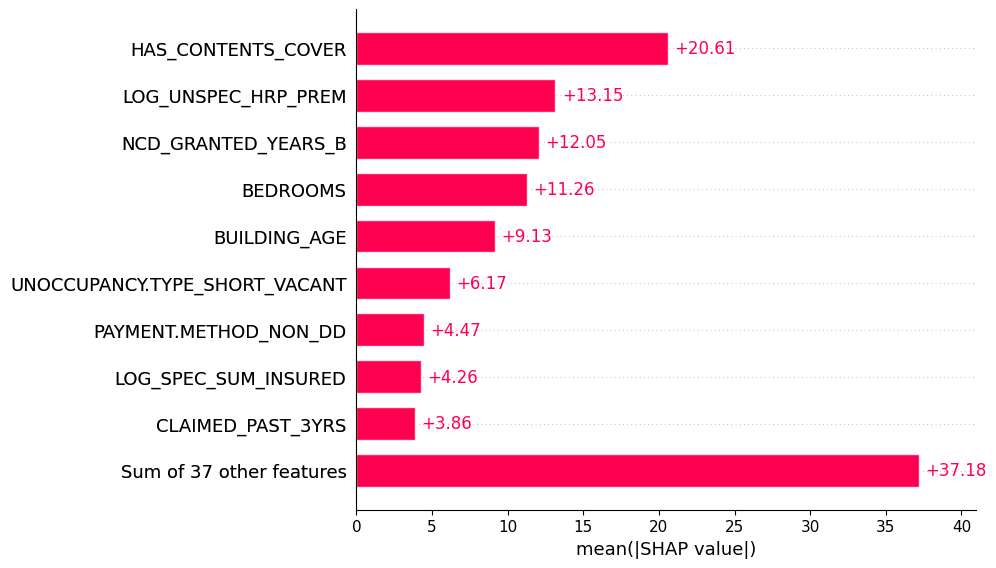

In [ ]:
# ============================================================
# Reload KNN SHAP artifacts and plot bar plots (10–100%)
# ============================================================
import numpy as np
import shap
import json

out_dir = "/content/drive/MyDrive/MSc Research/KNN/Explain"

# Fractions + labels
labels_fracs = [("10", 0.10), ("25", 0.25), ("50", 0.50), ("75", 0.75), ("100", 1.00)]

for lab, frac in labels_fracs:
    print(f"\n=== Plotting KNN SHAP bar plot for {lab}% sample ===")

    # Load SHAP arrays
    npz = np.load(f"{out_dir}/knn_shap_values_{lab}.npz", allow_pickle=True)
    shap_vals  = npz["shap_values"]
    feat_names = npz["feature_names"].astype(str)

    # Optional: read meta for a quick sanity check
    try:
        with open(f"{out_dir}/knn_shap_meta_{lab}.json") as f:
            meta = json.load(f)
        print(f"→ Expected rows (meta): {meta.get('n_rows')}, SHAP shape: {shap_vals.shape}")
    except FileNotFoundError:
        print("→ meta.json not found; continuing.")

    # Wrap into SHAP Explanation and plot bar (top 10)
    shap_exp = shap.Explanation(values=shap_vals, feature_names=feat_names)
    shap.plots.bar(shap_exp, max_display=10)


## **Local Explanations: LIME**

In [ ]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=af04bc0f2a33531fd50067d6ea9cf8e98addbddbd805a6118fd2528f663ad082
  Stored in directory: /root/.cache/pip/wheels/e7/5d/0e/4b4fff9a47468fed5633211fb3b76d1db43fe806a17fb7486a
Successfully built lime


### **Random Forest**


=== LIME for RF model (10%) ===


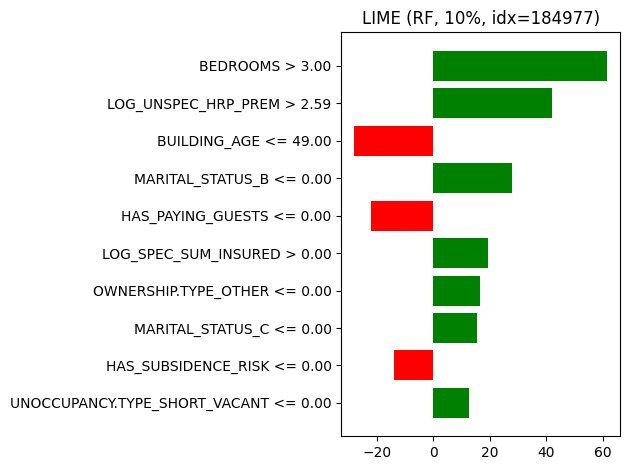


=== LIME for RF model (25%) ===


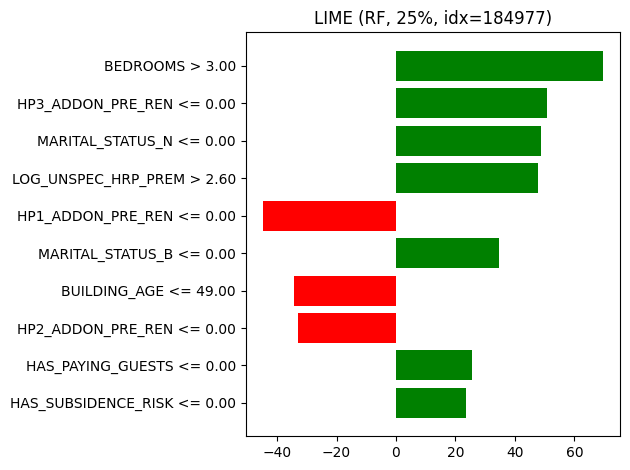


=== LIME for RF model (50%) ===


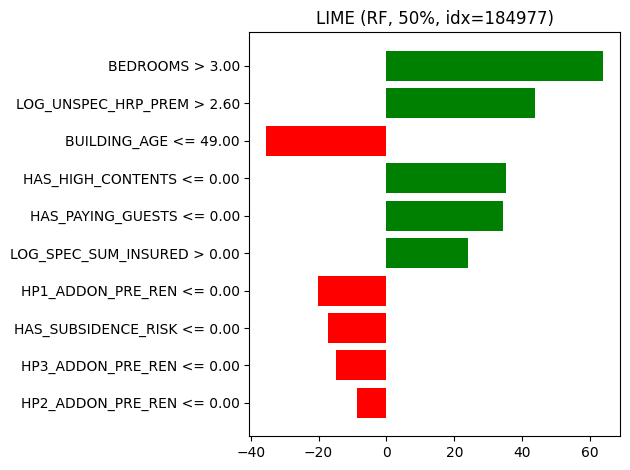


=== LIME for RF model (75%) ===


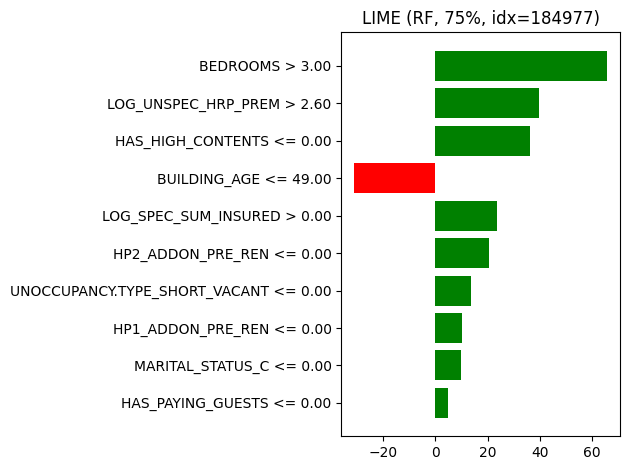


=== LIME for RF model (100%) ===


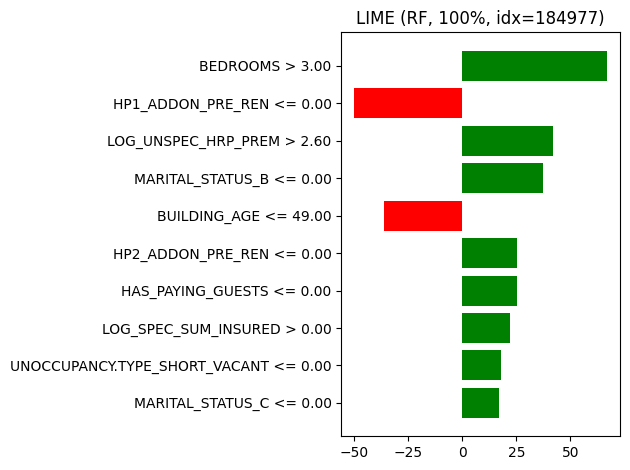

In [ ]:
import os, joblib, pandas as pd, numpy as np, matplotlib.pyplot as plt
import lime, lime.lime_tabular

out_dir = "/content/drive/MyDrive/MSc Research/Random Forest/Explain/LIME"
os.makedirs(out_dir, exist_ok=True)

df = pd.read_pickle("/content/drive/MyDrive/MSc Research/final_df.pkl")
X = df.drop(columns=["PREMIUM"])
feature_names = X.columns.tolist()

models = {
    "10%": "/content/drive/MyDrive/MSc Research/Random Forest/rf_model_10percent.pkl",
    "25%": "/content/drive/MyDrive/MSc Research/Random Forest/rf_model_25_%.joblib",
    "50%": "/content/drive/MyDrive/MSc Research/Random Forest/random_forest_50%.joblib",
    "75%": "/content/drive/MyDrive/MSc Research/Random Forest/rf_75pct_model.joblib",
    "100%": "/content/drive/MyDrive/MSc Research/Random Forest/rf_100pct_model.joblib"
}

forced_index = 184977

for lab, path in models.items():
    print(f"\n=== LIME for RF model ({lab}) ===")
    rf_model = joblib.load(path)

    frac = 1.0 if lab == "100%" else float(lab.strip("%")) / 100.0
    X_frac = X.sample(frac=frac, random_state=42)

    if forced_index not in X_frac.index:
        print(f"Index {forced_index} not in {lab} sample → using full dataset.")
        X_frac = X

    instance = X_frac.loc[forced_index].values

    explainer = lime.lime_tabular.LimeTabularExplainer(
        training_data=X_frac.values,
        feature_names=feature_names,
        mode="regression"
    )

    exp = explainer.explain_instance(
        data_row=instance,
        predict_fn=lambda A: rf_model.predict(pd.DataFrame(A, columns=feature_names)),
        num_features=10
    )

    try: exp.show_in_notebook(show_table=True)
    except: pass

    fig = exp.as_pyplot_figure()
    plt.title(f"LIME (RF, {lab}, idx={forced_index})")
    plt.tight_layout(); plt.show()

    fig.savefig(os.path.join(out_dir, f"rf_lime_{lab}_idx{forced_index}.png"), dpi=200, bbox_inches="tight")
    exp.save_to_file(os.path.join(out_dir, f"rf_lime_{lab}_idx{forced_index}.html"))
    plt.close(fig)


### **XGboost**


=== LIME for XGB model (10%) ===
Index 66 not in 10% subsample → using full dataset instead.
Using forced index 66
LOG_UNSPEC_HRP_PREM     3.201526
LOG_SPEC_SUM_INSURED    7.003974
Name: 66, dtype: float64


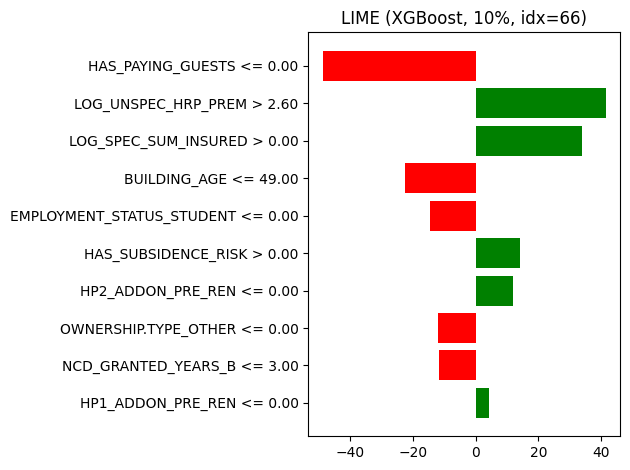

✅ Saved PNG: /content/drive/MyDrive/MSc Research/XGBoost/Explain/LIME/xgb_lime_10pct_idx66.png
✅ Saved HTML: /content/drive/MyDrive/MSc Research/XGBoost/Explain/LIME/xgb_lime_10pct_idx66.html

=== LIME for XGB model (25%) ===
-> Skipping 25%: model not loaded

=== LIME for XGB model (50%) ===
Index 66 not in 50% subsample → using full dataset instead.
Using forced index 66
LOG_UNSPEC_HRP_PREM     3.201526
LOG_SPEC_SUM_INSURED    7.003974
Name: 66, dtype: float64


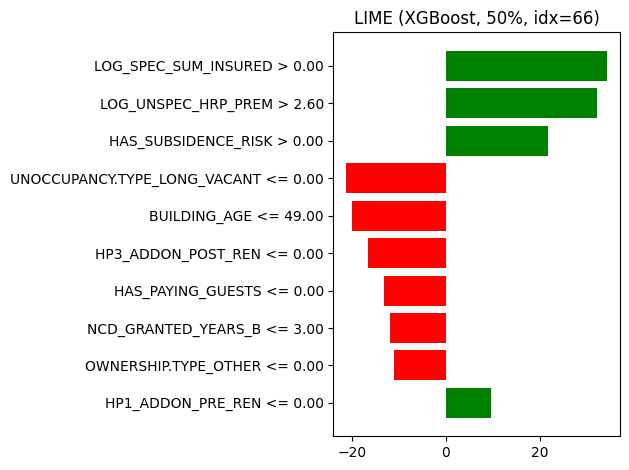

✅ Saved PNG: /content/drive/MyDrive/MSc Research/XGBoost/Explain/LIME/xgb_lime_50pct_idx66.png
✅ Saved HTML: /content/drive/MyDrive/MSc Research/XGBoost/Explain/LIME/xgb_lime_50pct_idx66.html

=== LIME for XGB model (75%) ===
Index 66 not in 75% subsample → using full dataset instead.
Using forced index 66
LOG_UNSPEC_HRP_PREM     3.201526
LOG_SPEC_SUM_INSURED    7.003974
Name: 66, dtype: float64


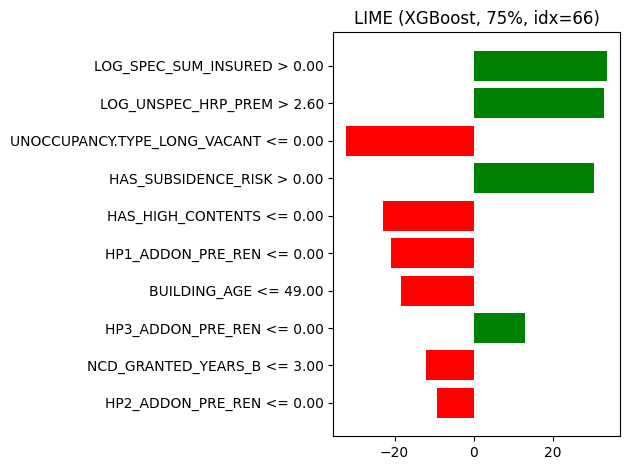

✅ Saved PNG: /content/drive/MyDrive/MSc Research/XGBoost/Explain/LIME/xgb_lime_75pct_idx66.png
✅ Saved HTML: /content/drive/MyDrive/MSc Research/XGBoost/Explain/LIME/xgb_lime_75pct_idx66.html

=== LIME for XGB model (100%) ===
Using forced index 66
LOG_UNSPEC_HRP_PREM     3.201526
LOG_SPEC_SUM_INSURED    7.003974
Name: 66, dtype: float64


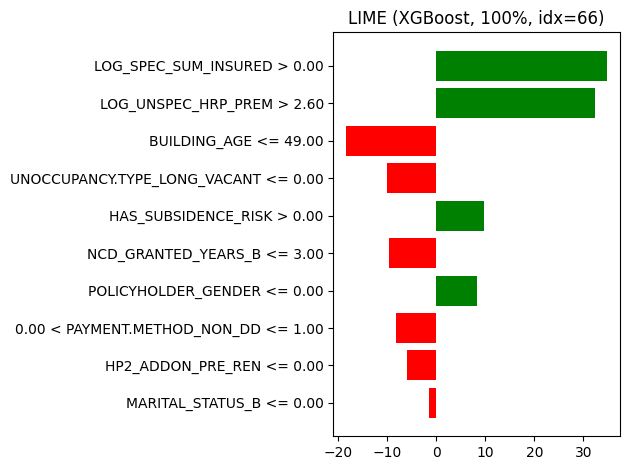

✅ Saved PNG: /content/drive/MyDrive/MSc Research/XGBoost/Explain/LIME/xgb_lime_100pct_idx66.png
✅ Saved HTML: /content/drive/MyDrive/MSc Research/XGBoost/Explain/LIME/xgb_lime_100pct_idx66.html

🎉 Done. LIME (XGBoost) explanations saved to: /content/drive/MyDrive/MSc Research/XGBoost/Explain/LIME


In [ ]:
# If needed:
# !pip install lime xgboost

import os, joblib, numpy as np, pandas as pd, matplotlib.pyplot as plt
import lime, lime.lime_tabular
import xgboost as xgb
from pathlib import Path

# --------------------------
# Paths & data
# --------------------------
out_dir = "/content/drive/MyDrive/MSc Research/XGBoost/Explain/LIME"
os.makedirs(out_dir, exist_ok=True)

df = pd.read_pickle("/content/drive/MyDrive/MSc Research/final_df.pkl")
X = df.drop(columns=["PREMIUM"])
feature_names = X.columns.tolist()

# Fractions per label
def label_to_frac(lab: str) -> float:
    return 1.0 if lab == "100%" else float(lab.strip("%")) / 100.0

# --------------------------
# Models
# --------------------------
models = {
    "10%": "/content/drive/MyDrive/MSc Research/HPT_10_grid/xgb_best10.json",
    "25%": "/content/drive/MyDrive/MSc Research/HPT_25_grid/results25.pkl",  # skip if not model
    "50%": "/content/drive/MyDrive/MSc Research/HPT_50_grid/xgb_best50.json",
    "75%": "/content/drive/MyDrive/MSc Research/HPT_75/xgb_best75.pkl",
    "100%": "/content/drive/MyDrive/MSc Research/HPT_full_grid/xgb_best_full.pkl",
}

# --------------------------
# Model loader
# --------------------------
def load_xgb_predict_fn(path):
    p = Path(path)
    if not p.exists():
        print(f"!! Missing: {path}")
        return None

    if p.suffix.lower() == ".json":
        try:
            booster = xgb.Booster()
            booster.load_model(str(p))
            def predict_fn(X_np):
                dm = xgb.DMatrix(X_np, feature_names=feature_names)
                return booster.predict(dm).ravel()
            return predict_fn
        except Exception as e:
            print(f"!! Failed to load Booster: {e}")
            return None

    if p.suffix.lower() == ".pkl":
        try:
            obj = joblib.load(str(p))
            if hasattr(obj, "predict"):  # sklearn API
                return lambda X_np: np.asarray(obj.predict(X_np)).ravel()
            if isinstance(obj, xgb.Booster):
                def predict_fn(X_np):
                    dm = xgb.DMatrix(X_np, feature_names=feature_names)
                    return obj.predict(dm).ravel()
                return predict_fn
            return None
        except Exception as e:
            print(f"!! Failed to load {path}: {e}")
            return None

    return None

# --------------------------
# Forced instance
# --------------------------
forced_index = 66

# --------------------------
# LIME loop
# --------------------------
for lab, path in models.items():
    print(f"\n=== LIME for XGB model ({lab}) ===")
    predict_fn = load_xgb_predict_fn(path)
    if predict_fn is None:
        print(f"-> Skipping {lab}: model not loaded")
        continue

    frac = label_to_frac(lab)
    X_frac = X.sample(frac=frac, random_state=42)

    # If forced index not in subsample → fallback to full dataset
    if forced_index not in X_frac.index:
        print(f"Index {forced_index} not in {lab} subsample → using full dataset instead.")
        X_frac = X

    # Use the forced row
    instance = X_frac.loc[forced_index].values
    print(f"Using forced index {forced_index}")
    print(X_frac.loc[forced_index][["LOG_UNSPEC_HRP_PREM", "LOG_SPEC_SUM_INSURED"]])

    # Build explainer
    explainer = lime.lime_tabular.LimeTabularExplainer(
        training_data=X_frac.values,
        feature_names=feature_names,
        mode="regression"
    )

    exp = explainer.explain_instance(
        data_row=instance,
        predict_fn=predict_fn,
        num_features=10
    )

    # Interactive (if notebook)
    try:
        exp.show_in_notebook(show_table=True)
    except Exception as e:
        print("Notebook display skipped:", e)

    # Save outputs
    fig = exp.as_pyplot_figure()
    plt.title(f"LIME (XGBoost, {lab}, idx={forced_index})")
    plt.tight_layout()
    plt.show()

    save_png = os.path.join(out_dir, f"xgb_lime_{lab.replace('%','pct')}_idx{forced_index}.png")
    fig.savefig(save_png, dpi=200, bbox_inches="tight")
    plt.close(fig)

    save_html = os.path.join(out_dir, f"xgb_lime_{lab.replace('%','pct')}_idx{forced_index}.html")
    exp.save_to_file(save_html)

    print(f"✅ Saved PNG: {save_png}")
    print(f"✅ Saved HTML: {save_html}")

print("\n🎉 Done. LIME (XGBoost) explanations saved to:", out_dir)


In [ ]:
# ---------------------------------------
# Find ALL indexes where:
# LOG_UNSPEC_HRP_PREM > 0
# LOG_SPEC_SUM_INSURED > 0
# ---------------------------------------

mask = (X["LOG_UNSPEC_HRP_PREM"] > 0) & (X["LOG_SPEC_SUM_INSURED"] > 0)

matching_rows = X[mask]

print("Number of matching rows:", len(matching_rows))
print("\nMatching indices:")
print(matching_rows.index.tolist())

# Optional: show the first few rows with feature values
print("\nPreview of matching rows:")
print(matching_rows[["LOG_UNSPEC_HRP_PREM", "LOG_SPEC_SUM_INSURED"]].head(10))


Number of matching rows: 10454

Matching indices:
[0, 11, 21, 23, 26, 57, 66, 80, 91, 98, 126, 127, 136, 138, 139, 167, 177, 179, 192, 198, 227, 234, 244, 250, 286, 347, 355, 369, 370, 385, 403, 430, 472, 474, 535, 545, 560, 568, 597, 598, 625, 636, 644, 660, 702, 725, 735, 752, 769, 780, 833, 835, 844, 870, 872, 892, 901, 913, 914, 922, 926, 1039, 1056, 1081, 1119, 1126, 1134, 1168, 1171, 1188, 1234, 1239, 1256, 1257, 1258, 1328, 1354, 1371, 1397, 1413, 1448, 1480, 1481, 1519, 1529, 1621, 1635, 1639, 1646, 1653, 1661, 1662, 1663, 1667, 1684, 1712, 1717, 1745, 1765, 1767, 1825, 1839, 1860, 1863, 1876, 1926, 1979, 1996, 2008, 2020, 2049, 2058, 2062, 2070, 2086, 2099, 2106, 2112, 2124, 2145, 2150, 2153, 2157, 2195, 2223, 2226, 2234, 2250, 2257, 2266, 2297, 2310, 2350, 2366, 2385, 2413, 2417, 2422, 2453, 2459, 2516, 2548, 2581, 2632, 2647, 2650, 2672, 2705, 2716, 2717, 2720, 2740, 2747, 2754, 2761, 2795, 2796, 2812, 2816, 2823, 2841, 2864, 2919, 2934, 2938, 2964, 2967, 3029, 3052, 3103, 3

### **KNN**


=== LIME for KNN model (10%) ===


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


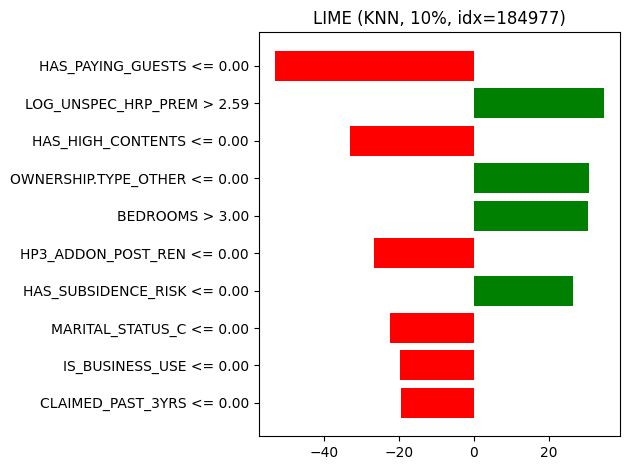


=== LIME for KNN model (25%) ===


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


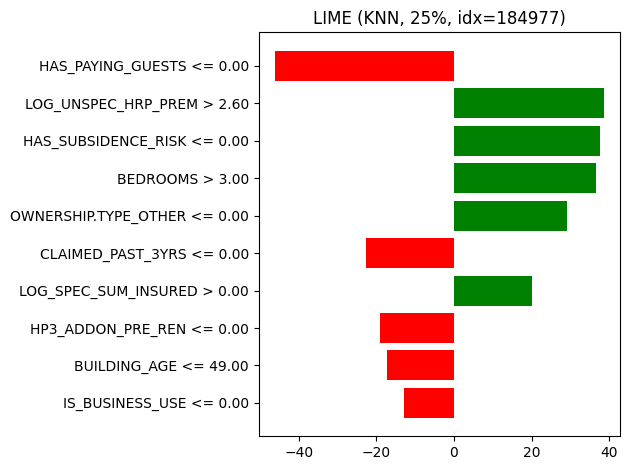


=== LIME for KNN model (50%) ===


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


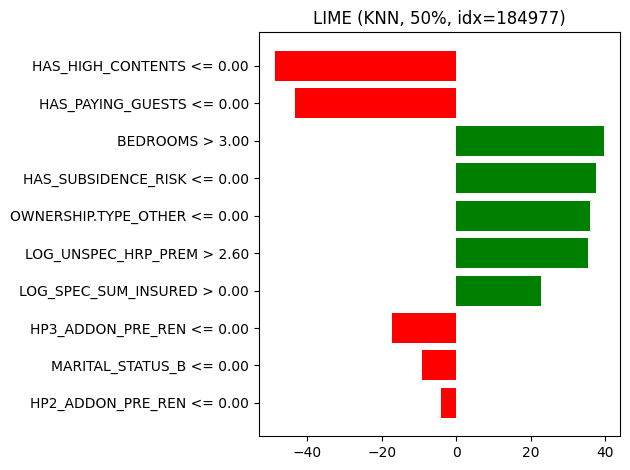


=== LIME for KNN model (75%) ===


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


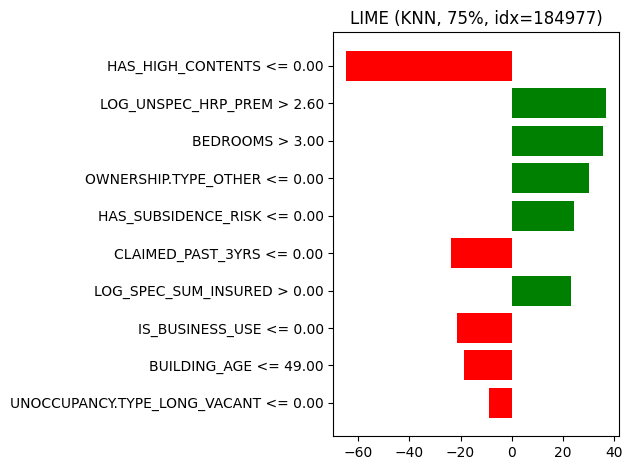


=== LIME for KNN model (100%) ===


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


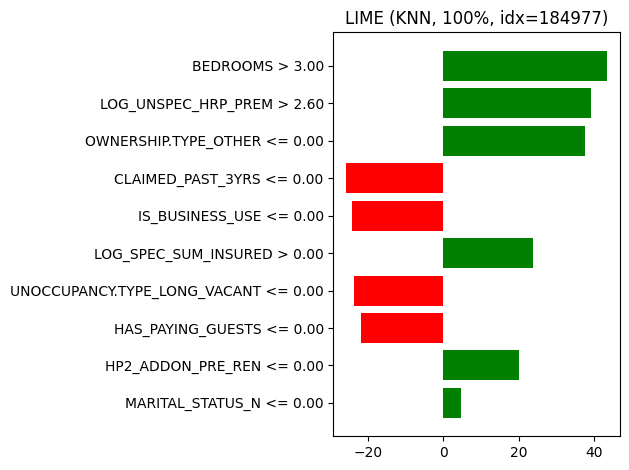

In [ ]:
import os, joblib, numpy as np, pandas as pd, matplotlib.pyplot as plt
import lime, lime.lime_tabular
from pathlib import Path

out_dir = "/content/drive/MyDrive/MSc Research/KNN/Explain/LIME"
os.makedirs(out_dir, exist_ok=True)

df = pd.read_pickle("/content/drive/MyDrive/MSc Research/final_df.pkl")
X = df.drop(columns=["PREMIUM"])
feature_names = X.columns.tolist()

models = {
    "10%": "/content/drive/MyDrive/MSc Research/KNN/knn_10.joblib",
    "25%": "/content/drive/MyDrive/MSc Research/KNN/knn_25.joblib",
    "50%": "/content/drive/MyDrive/MSc Research/KNN/knn_50.joblib",
    "75%": "/content/drive/MyDrive/MSc Research/KNN/knn_75.joblib",
    "100%": "/content/drive/MyDrive/MSc Research/KNN/knn_100.joblib",
}

forced_index = 184977

def load_knn_predict_fn(path):
    obj = joblib.load(path)
    if hasattr(obj, "predict"):
        return lambda X_np: np.asarray(obj.predict(X_np)).ravel()
    return None

for lab, path in models.items():
    print(f"\n=== LIME for KNN model ({lab}) ===")
    predict_fn = load_knn_predict_fn(path)
    if predict_fn is None: continue

    frac = 1.0 if lab == "100%" else float(lab.strip("%")) / 100.0
    X_frac = X.sample(frac=frac, random_state=42)

    if forced_index not in X_frac.index:
        print(f"Index {forced_index} not in {lab} sample → using full dataset.")
        X_frac = X

    instance = X_frac.loc[forced_index].values

    explainer = lime.lime_tabular.LimeTabularExplainer(
        training_data=X_frac.values,
        feature_names=feature_names,
        mode="regression"
    )

    exp = explainer.explain_instance(instance, predict_fn, num_features=10)

    try: exp.show_in_notebook(show_table=True)
    except: pass

    fig = exp.as_pyplot_figure()
    plt.title(f"LIME (KNN, {lab}, idx={forced_index})")
    plt.tight_layout(); plt.show()

    fig.savefig(os.path.join(out_dir, f"knn_lime_{lab}_idx{forced_index}.png"), dpi=200, bbox_inches="tight")
    exp.save_to_file(os.path.join(out_dir, f"knn_lime_{lab}_idx{forced_index}.html"))
    plt.close(fig)


### **Lasso**


=== LIME for Lasso model (10%) ===


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LassoCV was fitted with feature names
  warnings.warn(


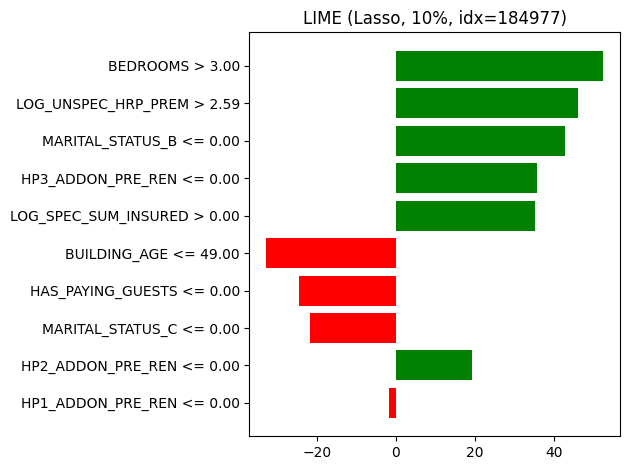


=== LIME for Lasso model (25%) ===


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LassoCV was fitted with feature names
  warnings.warn(


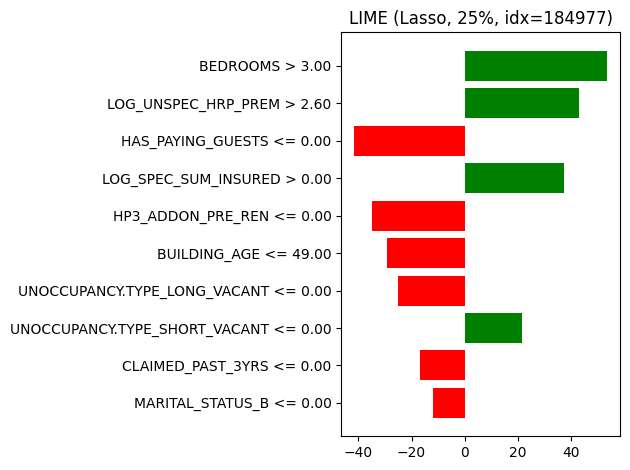


=== LIME for Lasso model (50%) ===


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LassoCV was fitted with feature names
  warnings.warn(


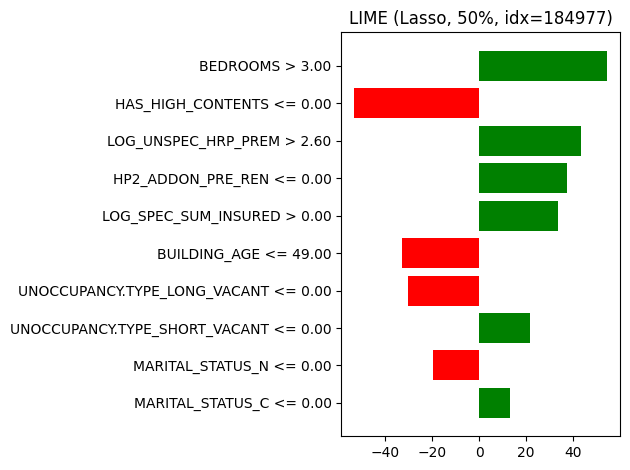


=== LIME for Lasso model (75%) ===


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LassoCV was fitted with feature names
  warnings.warn(


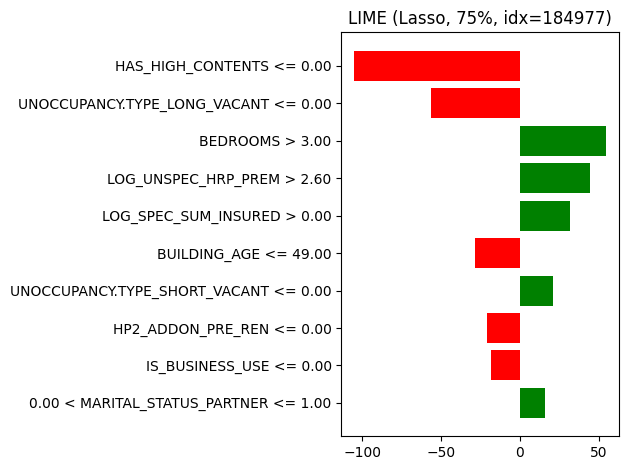


=== LIME for Lasso model (100%) ===


/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LassoCV was fitted with feature names
  warnings.warn(


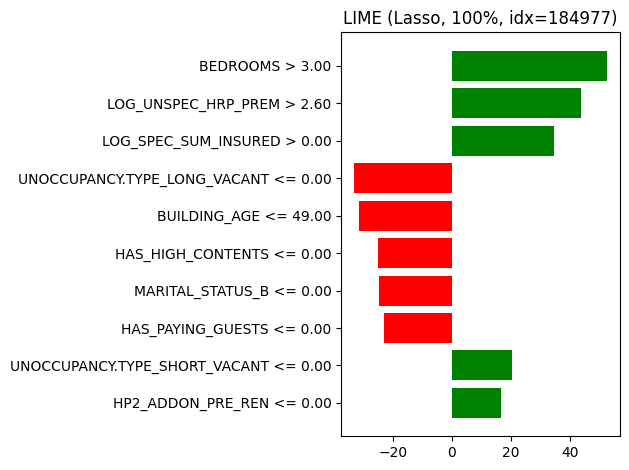

In [ ]:
import os, joblib, numpy as np, pandas as pd, matplotlib.pyplot as plt
import lime, lime.lime_tabular
from pathlib import Path

out_dir = "/content/drive/MyDrive/MSc Research/Lasso/Explain/LIME"
os.makedirs(out_dir, exist_ok=True)

df = pd.read_pickle("/content/drive/MyDrive/MSc Research/final_df.pkl")
X = df.drop(columns=["PREMIUM"])
feature_names = X.columns.tolist()

models = {
    "10%": "/content/drive/MyDrive/MSc Research/Lasso/lasso_10.joblib",
    "25%": "/content/drive/MyDrive/MSc Research/Lasso/lasso_25.joblib",
    "50%": "/content/drive/MyDrive/MSc Research/Lasso/lasso_50.joblib",
    "75%": "/content/drive/MyDrive/MSc Research/Lasso/lasso_75.joblib",
    "100%": "/content/drive/MyDrive/MSc Research/Lasso/lasso_100.joblib",
}

forced_index = 184977

def load_lasso_predict_fn(path):
    obj = joblib.load(path)
    if hasattr(obj, "predict"):
        return lambda X_np: np.asarray(obj.predict(X_np)).ravel()
    return None

for lab, path in models.items():
    print(f"\n=== LIME for Lasso model ({lab}) ===")
    predict_fn = load_lasso_predict_fn(path)
    if predict_fn is None: continue

    frac = 1.0 if lab == "100%" else float(lab.strip("%")) / 100.0
    X_frac = X.sample(frac=frac, random_state=42)

    if forced_index not in X_frac.index:
        print(f"Index {forced_index} not in {lab} sample → using full dataset.")
        X_frac = X

    instance = X_frac.loc[forced_index].values

    explainer = lime.lime_tabular.LimeTabularExplainer(
        training_data=X_frac.values,
        feature_names=feature_names,
        mode="regression"
    )

    exp = explainer.explain_instance(instance, predict_fn, num_features=10)

    try: exp.show_in_notebook(show_table=True)
    except: pass

    fig = exp.as_pyplot_figure()
    plt.title(f"LIME (Lasso, {lab}, idx={forced_index})")
    plt.tight_layout(); plt.show()

    fig.savefig(os.path.join(out_dir, f"lasso_lime_{lab}_idx{forced_index}.png"), dpi=200, bbox_inches="tight")
    exp.save_to_file(os.path.join(out_dir, f"lasso_lime_{lab}_idx{forced_index}.html"))
    plt.close(fig)
